In [2]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import missingno as msno

# Load Air Quality dataset

In [3]:
df=pd.read_csv('Data/AQI_Dataset.csv')

In [4]:
pd.set_option('display.max_columns', None)

In [5]:
df

,Timestamp,PM2.5 (µg/m³),PM10 (µg/m³),NO (µg/m³),NO2 (µg/m³),NOx (ppb),NH3 (µg/m³),SO2 (µg/m³),CO (mg/m³),Ozone (µg/m³),Benzene (µg/m³),Toluene (µg/m³),Xylene (µg/m³),O Xylene (µg/m³),Eth-Benzene (µg/m³),MP-Xylene (µg/m³),AT (°C),RH (%),WS (m/s),WD (deg),RF (mm),TOT-RF (mm),SR (W/mt2),BP (mmHg),VWS (m/s),AQI
0,2019-01-01 00:00:00,408.25,567.25,248.030,146.600,279.880,43.200,20.880000,4.150000,2.100,11.900,57.070,NaN,NaN,NaN,NaN,9.450,91.020,0.200,138.900,0.0,0.0,1.030,996.40,NaN,486.0
1,2019-01-01 01:00:00,466.75,606.75,230.750,101.200,242.120,43.500,16.120000,4.750000,2.950,13.050,60.320,NaN,NaN,NaN,NaN,8.900,95.500,0.300,160.200,0.0,0.0,0.880,996.38,NaN,486.0
2,2019-01-01 02:00:00,496.00,663.25,179.600,80.950,189.100,37.550,14.850000,4.100000,1.900,13.220,63.750,NaN,NaN,NaN,NaN,8.620,97.230,0.280,145.150,0.0,0.0,1.000,996.18,NaN,500.0
3,2019-01-01 03:00:00,467.25,640.00,142.550,66.270,151.600,43.030,14.150000,3.680000,2.150,15.200,68.920,NaN,NaN,NaN,NaN,8.150,99.050,0.280,128.230,0.0,0.0,1.180,995.90,NaN,500.0
4,2019-01-01 04:00:00,453.25,615.50,92.870,56.630,105.920,42.000,12.400000,2.900000,1.900,15.800,66.900,NaN,NaN,NaN,NaN,7.600,99.400,0.250,113.400,0.0,0.0,1.250,995.20,NaN,500.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
43819,2023-12-31 19:00:00,230.50,425.25,6.850,32.175,39.025,59.425,7.533333,1.266667,2.575,0.800,2.075,NaN,NaN,NaN,NaN,11.575,83.000,1.025,59.800,0.0,0.0,5.250,983.00,NaN,410.0
43820,2023-12-31 20:00:00,238.50,433.25,5.575,30.200,35.750,58.750,8.225000,1.325000,2.700,0.800,1.775,NaN,NaN,NaN,NaN,11.425,83.225,1.025,58.425,0.0,0.0,5.250,983.00,NaN,391.0
43821,2023-12-31 21:00:00,233.00,417.50,5.625,26.550,32.200,57.875,7.650000,1.150000,2.650,0.725,1.725,NaN,NaN,NaN,NaN,11.200,83.425,1.000,59.125,0.0,0.0,5.425,983.10,NaN,401.0
43822,2023-12-31 22:00:00,208.75,353.00,5.200,25.125,30.350,56.925,8.625000,1.025000,2.925,0.725,1.450,NaN,NaN,NaN,NaN,11.025,83.975,1.100,58.025,0.0,0.0,5.125,983.10,NaN,402.0


In [6]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 43824 entries, 0 to 43823
Data columns (total 26 columns):
 #   Column               Non-Null Count  Dtype  
---  ------               --------------  -----  
 0   Timestamp            43824 non-null  object 
 1   PM2.5 (µg/m³)        41192 non-null  float64
 2   PM10 (µg/m³)         41713 non-null  float64
 3   NO (µg/m³)           42411 non-null  float64
 4   NO2 (µg/m³)          42464 non-null  float64
 5   NOx (ppb)            42480 non-null  float64
 6   NH3 (µg/m³)          41803 non-null  float64
 7   SO2 (µg/m³)          42448 non-null  float64
 8   CO (mg/m³)           41423 non-null  float64
 9   Ozone (µg/m³)        41725 non-null  float64
 10  Benzene (µg/m³)      41402 non-null  float64
 11  Toluene (µg/m³)      42140 non-null  float64
 12  Xylene (µg/m³)       0 non-null      float64
 13  O Xylene (µg/m³)     0 non-null      float64
 14  Eth-Benzene (µg/m³)  0 non-null      float64
 15  MP-Xylene (µg/m³)    0 non-null     

# Data Exporation

In [7]:
df.rename(columns={'Timestamp':'Datetime','PM2.5 (µg/m³)':'PM2.5','PM10 (µg/m³)':'PM10','NO (µg/m³)':'NO','NO2 (µg/m³)':'NO2','NOx (ppb)':'NOx','NH3 (µg/m³)':'NH3',
                   'SO2 (µg/m³)':'SO2','CO (mg/m³)':'CO','Ozone (µg/m³)':'Ozone','Benzene (µg/m³)':'Benzene','Toluene (µg/m³)':'Toluene','AT (°C)':'Temperature',
                   'RH (%)':'RH','WS (m/s)':'Wind_Speed','WD (deg)':'Wind_Direction','RF (mm)':'Rainfall','TOT-RF (mm)':'Tot-RF','SR (W/mt2)':'Solar_Radiation',
                   'BP (mmHg)':'Barometric Pressure'},inplace=True)

In [8]:
df

,Datetime,PM2.5,PM10,NO,NO2,NOx,NH3,SO2,CO,Ozone,Benzene,Toluene,Xylene (µg/m³),O Xylene (µg/m³),Eth-Benzene (µg/m³),MP-Xylene (µg/m³),Temperature,RH,Wind_Speed,Wind_Direction,Rainfall,Tot-RF,Solar_Radiation,Barometric Pressure,VWS (m/s),AQI
0,2019-01-01 00:00:00,408.25,567.25,248.030,146.600,279.880,43.200,20.880000,4.150000,2.100,11.900,57.070,NaN,NaN,NaN,NaN,9.450,91.020,0.200,138.900,0.0,0.0,1.030,996.40,NaN,486.0
1,2019-01-01 01:00:00,466.75,606.75,230.750,101.200,242.120,43.500,16.120000,4.750000,2.950,13.050,60.320,NaN,NaN,NaN,NaN,8.900,95.500,0.300,160.200,0.0,0.0,0.880,996.38,NaN,486.0
2,2019-01-01 02:00:00,496.00,663.25,179.600,80.950,189.100,37.550,14.850000,4.100000,1.900,13.220,63.750,NaN,NaN,NaN,NaN,8.620,97.230,0.280,145.150,0.0,0.0,1.000,996.18,NaN,500.0
3,2019-01-01 03:00:00,467.25,640.00,142.550,66.270,151.600,43.030,14.150000,3.680000,2.150,15.200,68.920,NaN,NaN,NaN,NaN,8.150,99.050,0.280,128.230,0.0,0.0,1.180,995.90,NaN,500.0
4,2019-01-01 04:00:00,453.25,615.50,92.870,56.630,105.920,42.000,12.400000,2.900000,1.900,15.800,66.900,NaN,NaN,NaN,NaN,7.600,99.400,0.250,113.400,0.0,0.0,1.250,995.20,NaN,500.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
43819,2023-12-31 19:00:00,230.50,425.25,6.850,32.175,39.025,59.425,7.533333,1.266667,2.575,0.800,2.075,NaN,NaN,NaN,NaN,11.575,83.000,1.025,59.800,0.0,0.0,5.250,983.00,NaN,410.0
43820,2023-12-31 20:00:00,238.50,433.25,5.575,30.200,35.750,58.750,8.225000,1.325000,2.700,0.800,1.775,NaN,NaN,NaN,NaN,11.425,83.225,1.025,58.425,0.0,0.0,5.250,983.00,NaN,391.0
43821,2023-12-31 21:00:00,233.00,417.50,5.625,26.550,32.200,57.875,7.650000,1.150000,2.650,0.725,1.725,NaN,NaN,NaN,NaN,11.200,83.425,1.000,59.125,0.0,0.0,5.425,983.10,NaN,401.0
43822,2023-12-31 22:00:00,208.75,353.00,5.200,25.125,30.350,56.925,8.625000,1.025000,2.925,0.725,1.450,NaN,NaN,NaN,NaN,11.025,83.975,1.100,58.025,0.0,0.0,5.125,983.10,NaN,402.0


## Converting to datetime

In [9]:
df['Datetime']=pd.to_datetime(df['Datetime'], format='%Y-%m-%d %H:%M:%S')
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 43824 entries, 0 to 43823
Data columns (total 26 columns):
 #   Column               Non-Null Count  Dtype         
---  ------               --------------  -----         
 0   Datetime             43824 non-null  datetime64[ns]
 1   PM2.5                41192 non-null  float64       
 2   PM10                 41713 non-null  float64       
 3   NO                   42411 non-null  float64       
 4   NO2                  42464 non-null  float64       
 5   NOx                  42480 non-null  float64       
 6   NH3                  41803 non-null  float64       
 7   SO2                  42448 non-null  float64       
 8   CO                   41423 non-null  float64       
 9   Ozone                41725 non-null  float64       
 10  Benzene              41402 non-null  float64       
 11  Toluene              42140 non-null  float64       
 12  Xylene (µg/m³)       0 non-null      float64       
 13  O Xylene (µg/m³)     0 non-null

In [10]:
filt=(df['Datetime']>=pd.to_datetime('2020-01-01')) & (df['Datetime']<=pd.to_datetime('2021-01-03'))
df.loc[filt]

,Datetime,PM2.5,PM10,NO,NO2,NOx,NH3,SO2,CO,Ozone,Benzene,Toluene,Xylene (µg/m³),O Xylene (µg/m³),Eth-Benzene (µg/m³),MP-Xylene (µg/m³),Temperature,RH,Wind_Speed,Wind_Direction,Rainfall,Tot-RF,Solar_Radiation,Barometric Pressure,VWS (m/s),AQI
8760,2020-01-01 00:00:00,583.0,759.50,78.85,41.30,86.32,46.08,9.70,2.50,3.75,NaN,57.62,NaN,NaN,NaN,NaN,7.32,89.78,0.32,62.68,0.0,0.0,1.30,995.50,NaN,500.0
8761,2020-01-01 01:00:00,393.0,502.00,56.72,35.88,65.32,41.62,7.05,NaN,4.40,13.15,49.72,NaN,NaN,NaN,NaN,7.18,90.22,0.32,40.80,0.0,0.0,1.38,995.35,NaN,500.0
8762,2020-01-01 02:00:00,337.5,447.50,51.02,32.78,59.05,40.80,5.45,NaN,4.47,11.58,54.75,NaN,NaN,NaN,NaN,7.05,90.48,0.30,98.62,0.0,0.0,1.17,995.30,NaN,494.0
8763,2020-01-01 03:00:00,328.5,438.00,63.62,29.08,67.38,41.75,3.92,NaN,4.40,11.92,41.10,NaN,NaN,NaN,NaN,6.82,92.10,0.30,61.72,0.0,0.0,1.27,995.28,NaN,459.0
8764,2020-01-01 04:00:00,327.0,426.00,63.25,26.32,65.60,42.30,3.45,NaN,4.00,12.65,39.70,NaN,NaN,NaN,NaN,6.72,92.85,0.35,96.40,0.0,0.0,1.18,995.32,NaN,446.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
17588,2021-01-02 20:00:00,388.0,523.50,49.42,93.65,90.10,50.30,28.38,1.02,2.95,13.40,59.10,NaN,NaN,NaN,NaN,16.70,66.80,0.35,122.58,0.0,0.0,0.98,990.48,NaN,446.0
17589,2021-01-02 21:00:00,382.0,527.00,58.80,83.55,92.35,48.90,23.75,1.27,2.92,12.27,54.72,NaN,NaN,NaN,NaN,15.75,69.52,0.25,114.80,0.0,0.0,0.92,990.75,NaN,483.0
17590,2021-01-02 22:00:00,346.5,478.25,32.78,78.72,68.58,49.40,21.88,0.35,2.05,10.35,48.20,NaN,NaN,NaN,NaN,15.75,65.73,0.18,91.32,0.0,0.0,0.95,990.80,NaN,479.0
17591,2021-01-02 23:00:00,300.0,406.50,29.48,68.47,60.45,47.22,19.23,0.92,2.50,9.02,32.90,NaN,NaN,NaN,NaN,15.15,69.80,0.18,119.02,0.0,0.0,1.10,990.62,NaN,458.0


## Setting Index

In [11]:
df.set_index('Datetime', inplace=True)
df.head(5)

,PM2.5,PM10,NO,NO2,NOx,NH3,SO2,CO,Ozone,Benzene,Toluene,Xylene (µg/m³),O Xylene (µg/m³),Eth-Benzene (µg/m³),MP-Xylene (µg/m³),Temperature,RH,Wind_Speed,Wind_Direction,Rainfall,Tot-RF,Solar_Radiation,Barometric Pressure,VWS (m/s),AQI
Datetime,,,,,,,,,,,,,,,,,,,,,,,,,
2019-01-01 00:00:00,408.25,567.25,248.03,146.60,279.88,43.20,20.88,4.15,2.10,11.90,57.07,NaN,NaN,NaN,NaN,9.45,91.02,0.20,138.90,0.0,0.0,1.03,996.40,NaN,486.0
2019-01-01 01:00:00,466.75,606.75,230.75,101.20,242.12,43.50,16.12,4.75,2.95,13.05,60.32,NaN,NaN,NaN,NaN,8.90,95.50,0.30,160.20,0.0,0.0,0.88,996.38,NaN,486.0
2019-01-01 02:00:00,496.00,663.25,179.60,80.95,189.10,37.55,14.85,4.10,1.90,13.22,63.75,NaN,NaN,NaN,NaN,8.62,97.23,0.28,145.15,0.0,0.0,1.00,996.18,NaN,500.0
2019-01-01 03:00:00,467.25,640.00,142.55,66.27,151.60,43.03,14.15,3.68,2.15,15.20,68.92,NaN,NaN,NaN,NaN,8.15,99.05,0.28,128.23,0.0,0.0,1.18,995.90,NaN,500.0
2019-01-01 04:00:00,453.25,615.50,92.87,56.63,105.92,42.00,12.40,2.90,1.90,15.80,66.90,NaN,NaN,NaN,NaN,7.60,99.40,0.25,113.40,0.0,0.0,1.25,995.20,NaN,500.0


In [12]:
df.loc['2020-07']

,PM2.5,PM10,NO,NO2,NOx,NH3,SO2,CO,Ozone,Benzene,Toluene,Xylene (µg/m³),O Xylene (µg/m³),Eth-Benzene (µg/m³),MP-Xylene (µg/m³),Temperature,RH,Wind_Speed,Wind_Direction,Rainfall,Tot-RF,Solar_Radiation,Barometric Pressure,VWS (m/s),AQI
Datetime,,,,,,,,,,,,,,,,,,,,,,,,,
2020-07-01 00:00:00,51.5,132.75,4.15,12.32,9.93,33.67,12.50,0.82,40.00,0.35,16.75,NaN,NaN,NaN,NaN,35.38,63.05,1.02,53.78,0.0,0.0,1.25,976.22,NaN,115.0
2020-07-01 01:00:00,58.5,123.75,3.70,10.38,8.55,21.22,9.25,0.78,14.20,0.40,17.27,NaN,NaN,NaN,NaN,34.95,64.35,1.18,50.65,0.0,0.0,1.35,975.97,NaN,123.0
2020-07-01 02:00:00,45.5,101.50,4.80,6.60,7.40,24.80,NaN,0.90,27.42,0.45,14.52,NaN,NaN,NaN,NaN,34.60,65.35,1.08,58.72,0.0,0.0,1.27,975.42,NaN,119.0
2020-07-01 03:00:00,39.5,82.75,4.28,8.20,7.88,20.78,NaN,0.90,31.33,0.40,12.98,NaN,NaN,NaN,NaN,34.40,66.40,0.90,60.18,0.0,0.0,1.32,975.48,NaN,107.0
2020-07-01 04:00:00,45.0,88.75,3.30,10.27,8.18,22.82,10.22,0.72,32.82,0.43,11.05,NaN,NaN,NaN,NaN,34.22,68.30,0.80,58.88,0.0,0.0,1.30,975.68,NaN,82.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2020-07-31 19:00:00,30.0,70.50,7.48,30.85,22.52,29.15,16.05,0.80,32.28,3.10,15.35,NaN,NaN,NaN,NaN,34.58,68.12,0.68,142.88,0.0,0.0,1.08,976.88,NaN,95.0
2020-07-31 20:00:00,28.5,66.00,6.02,32.08,21.98,28.60,16.58,0.98,26.90,3.32,14.23,NaN,NaN,NaN,NaN,34.20,70.35,0.57,136.70,0.0,0.0,0.95,977.35,NaN,75.0
2020-07-31 21:00:00,31.5,70.00,9.38,30.20,23.67,31.15,13.00,1.05,28.48,2.92,18.60,NaN,NaN,NaN,NaN,34.08,71.58,0.43,137.25,0.0,0.0,0.98,978.08,NaN,66.0


## Dropping columns with zero data

In [13]:
df.drop(columns=['Xylene (µg/m³)','O Xylene (µg/m³)','Eth-Benzene (µg/m³)','MP-Xylene (µg/m³)','VWS (m/s)'],inplace=True)

In [14]:
df.head(5)

,PM2.5,PM10,NO,NO2,NOx,NH3,SO2,CO,Ozone,Benzene,Toluene,Temperature,RH,Wind_Speed,Wind_Direction,Rainfall,Tot-RF,Solar_Radiation,Barometric Pressure,AQI
Datetime,,,,,,,,,,,,,,,,,,,,
2019-01-01 00:00:00,408.25,567.25,248.03,146.60,279.88,43.20,20.88,4.15,2.10,11.90,57.07,9.45,91.02,0.20,138.90,0.0,0.0,1.03,996.40,486.0
2019-01-01 01:00:00,466.75,606.75,230.75,101.20,242.12,43.50,16.12,4.75,2.95,13.05,60.32,8.90,95.50,0.30,160.20,0.0,0.0,0.88,996.38,486.0
2019-01-01 02:00:00,496.00,663.25,179.60,80.95,189.10,37.55,14.85,4.10,1.90,13.22,63.75,8.62,97.23,0.28,145.15,0.0,0.0,1.00,996.18,500.0
2019-01-01 03:00:00,467.25,640.00,142.55,66.27,151.60,43.03,14.15,3.68,2.15,15.20,68.92,8.15,99.05,0.28,128.23,0.0,0.0,1.18,995.90,500.0
2019-01-01 04:00:00,453.25,615.50,92.87,56.63,105.92,42.00,12.40,2.90,1.90,15.80,66.90,7.60,99.40,0.25,113.40,0.0,0.0,1.25,995.20,500.0


## Data analysis

In [15]:
df.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 43824 entries, 2019-01-01 00:00:00 to 2023-12-31 23:00:00
Data columns (total 20 columns):
 #   Column               Non-Null Count  Dtype  
---  ------               --------------  -----  
 0   PM2.5                41192 non-null  float64
 1   PM10                 41713 non-null  float64
 2   NO                   42411 non-null  float64
 3   NO2                  42464 non-null  float64
 4   NOx                  42480 non-null  float64
 5   NH3                  41803 non-null  float64
 6   SO2                  42448 non-null  float64
 7   CO                   41423 non-null  float64
 8   Ozone                41725 non-null  float64
 9   Benzene              41402 non-null  float64
 10  Toluene              42140 non-null  float64
 11  Temperature          42886 non-null  float64
 12  RH                   42910 non-null  float64
 13  Wind_Speed           42414 non-null  float64
 14  Wind_Direction       42414 non-null  float64
 15  R

In [16]:
df.describe()

,PM2.5,PM10,NO,NO2,NOx,NH3,SO2,CO,Ozone,Benzene,Toluene,Temperature,RH,Wind_Speed,Wind_Direction,Rainfall,Tot-RF,Solar_Radiation,Barometric Pressure,AQI
count,41192.000000,41713.000000,42411.000000,42464.000000,42480.000000,41803.000000,42448.000000,41423.000000,41725.000000,41402.000000,42140.000000,42886.000000,42910.000000,42414.000000,42414.000000,42920.000000,43824.000000,42918.000000,42887.000000,39975.000000
mean,107.893032,215.479633,25.900576,37.312126,45.721060,36.457167,15.848704,1.224037,29.003648,2.999326,18.530087,26.082880,63.468620,0.771255,116.498774,0.012294,0.787616,132.567037,980.257239,212.981088
std,106.620795,152.329382,50.808935,29.048075,53.675549,15.758599,13.202566,1.089889,33.101521,3.642059,26.933608,8.511086,19.333968,0.531127,64.307088,0.219732,156.511206,190.331449,11.688668,133.323452
min,0.250000,2.000000,0.100000,0.270000,2.850000,0.150000,0.100000,0.000000,0.100000,0.000000,0.000000,4.100000,7.700000,0.100000,0.200000,0.000000,0.000000,0.100000,781.100000,2.000000
25%,35.250000,101.750000,4.050000,17.300000,15.550000,25.670000,6.520000,0.620000,5.700000,0.620000,3.675000,19.200000,47.970000,0.350000,55.300000,0.000000,0.000000,1.550000,973.970000,101.000000
50%,69.000000,178.000000,6.900000,28.700000,25.850000,33.120000,13.210000,0.975000,16.200000,1.750000,10.020000,27.520000,63.900000,0.620000,111.122500,0.000000,0.000000,9.250000,980.820000,171.000000
75%,145.250000,289.250000,21.062500,49.400000,51.550000,43.950000,20.650000,1.420000,38.830000,3.970000,21.750000,32.670000,79.400000,1.080000,177.245000,0.000000,0.000000,231.795000,987.620000,325.000000
max,989.000000,996.000000,493.800000,289.380000,494.900000,249.425000,184.300000,9.900000,200.000000,44.700000,326.100000,46.750000,99.450000,5.350000,359.550000,21.280000,32764.000000,901.150000,1000.720000,500.000000


In [17]:
df['Rainfall'].isna().sum()

904

In [18]:
#zero count
(df['Rainfall']==0).sum()

42263

In [19]:
df['Rainfall'].shape[0]

43824

In [20]:
nonzero1=df['Rainfall'].shape[0]-df['Rainfall'].isna().sum()-(df['Rainfall']==0).sum()
nonzero1

657

In [21]:
nonzero2=df['Tot-RF'].shape[0]-df['Tot-RF'].isna().sum()-(df['Tot-RF']==0).sum()
nonzero2

658

# Data visualization

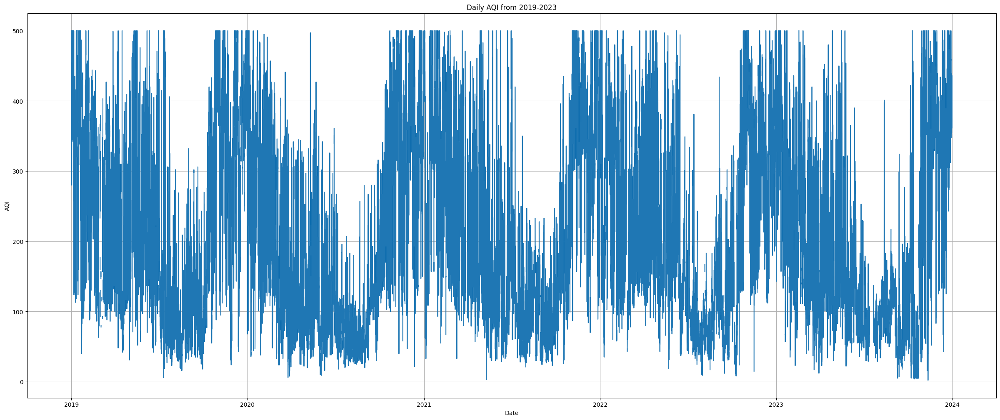

In [22]:
plt.figure(figsize=(30,12))
plt.plot(df.index,df['AQI'])
plt.title('Daily AQI from 2019-2023')
plt.xlabel('Date')
plt.ylabel('AQI')
plt.grid(True)
plt.show()

## Plotting Daily pollutant data

In [23]:
df.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 43824 entries, 2019-01-01 00:00:00 to 2023-12-31 23:00:00
Data columns (total 20 columns):
 #   Column               Non-Null Count  Dtype  
---  ------               --------------  -----  
 0   PM2.5                41192 non-null  float64
 1   PM10                 41713 non-null  float64
 2   NO                   42411 non-null  float64
 3   NO2                  42464 non-null  float64
 4   NOx                  42480 non-null  float64
 5   NH3                  41803 non-null  float64
 6   SO2                  42448 non-null  float64
 7   CO                   41423 non-null  float64
 8   Ozone                41725 non-null  float64
 9   Benzene              41402 non-null  float64
 10  Toluene              42140 non-null  float64
 11  Temperature          42886 non-null  float64
 12  RH                   42910 non-null  float64
 13  Wind_Speed           42414 non-null  float64
 14  Wind_Direction       42414 non-null  float64
 15  R

In [24]:
def plot_columns(data,columnn,start_date,end_date):
    filtered_data=data[start_date:end_date]
    for col in columnn:
        if col in filtered_data.columns:
            plt.figure(figsize=(26,8))
            plt.plot(filtered_data.index,filtered_data[col])
            plt.title(f'{col} Levels from {start_date} to {end_date}')
            plt.xlabel('Date')
            plt.ylabel(f'{col} level')
            plt.show()

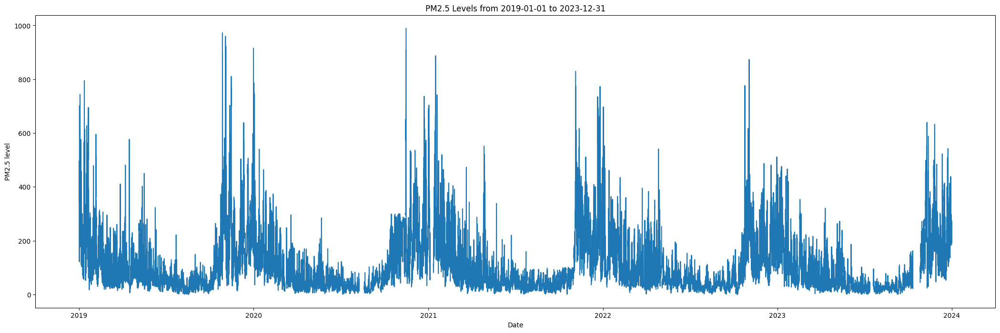

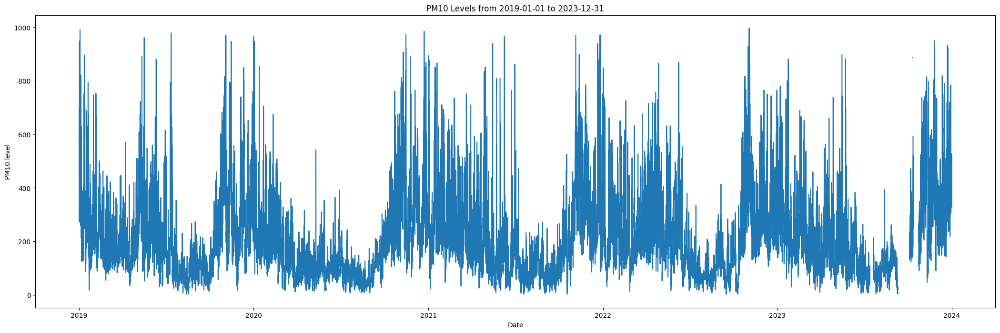

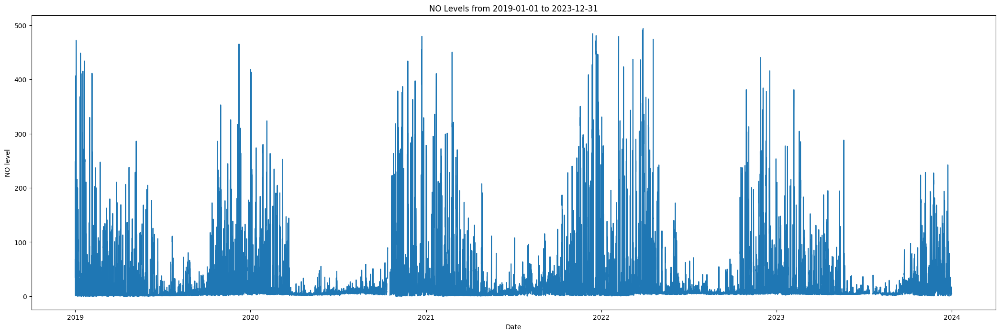

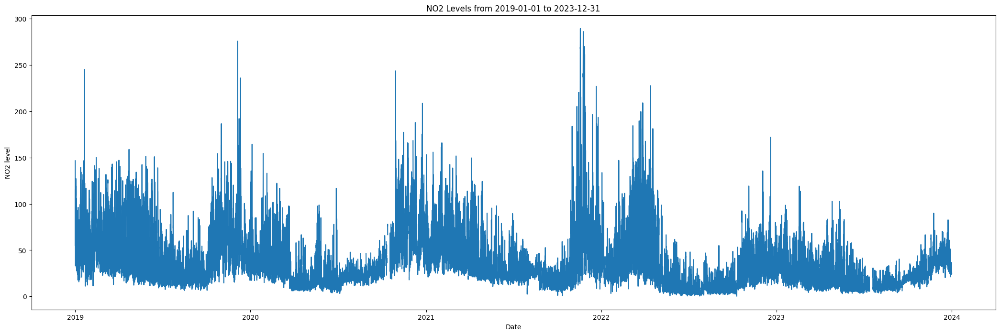

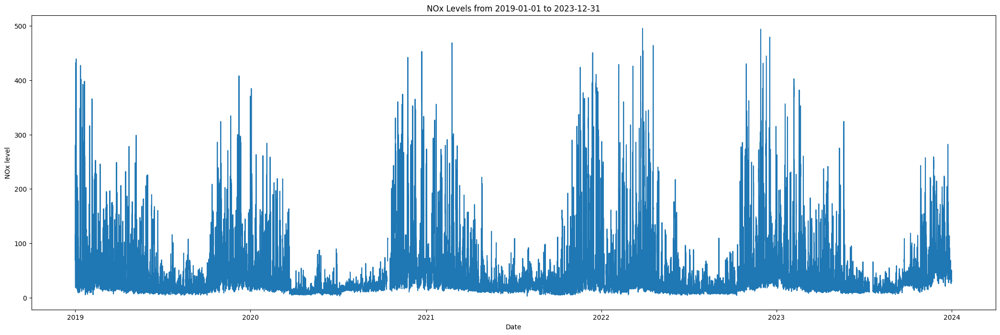

...

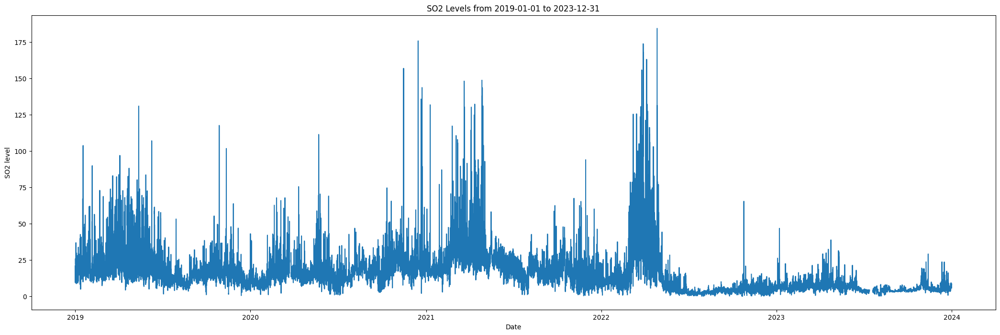

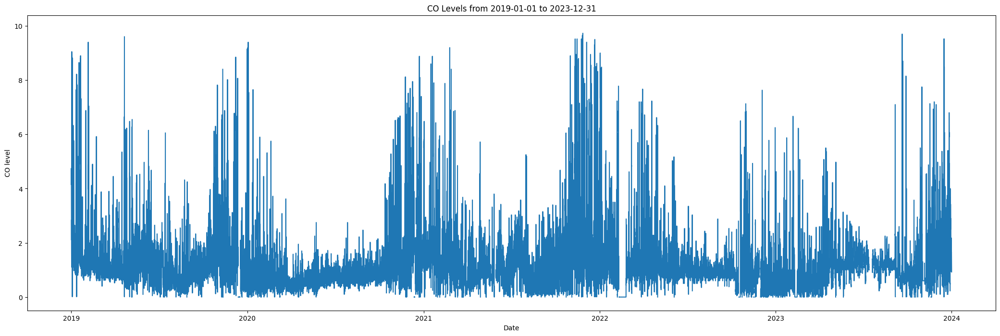

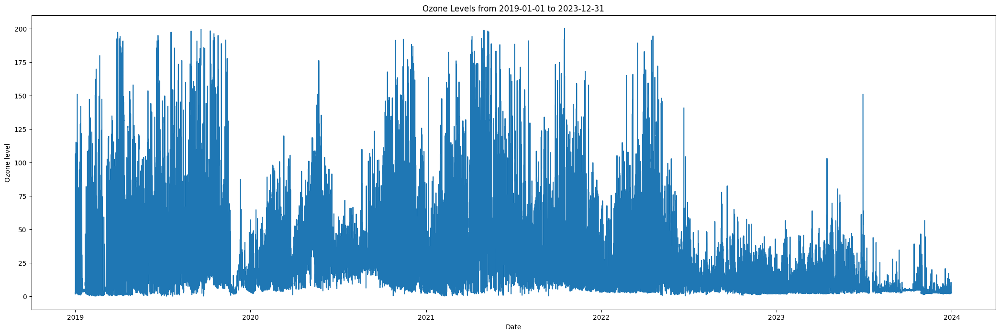

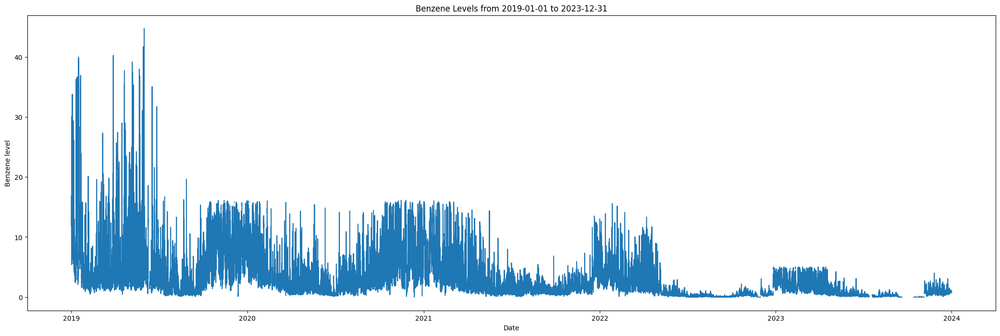

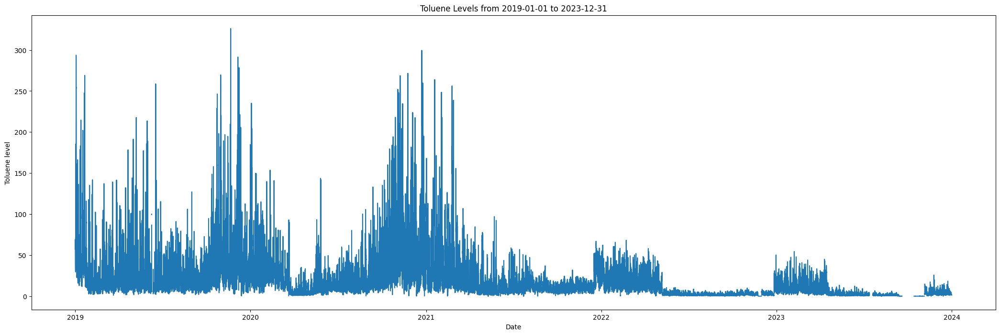

In [25]:
pollutant_list=['PM2.5','PM10','NO','NO2','NOx','NH3','SO2','CO','Ozone','Benzene','Toluene']
plot_columns(df,pollutant_list,'2019-01-01','2023-12-31')

## Plotting Daily meterological data

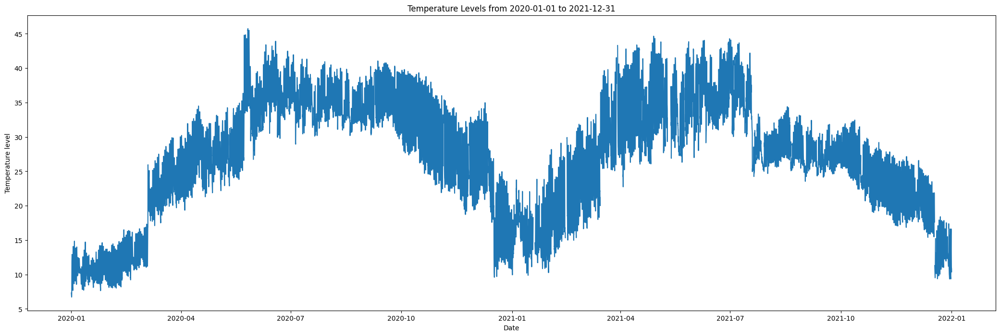

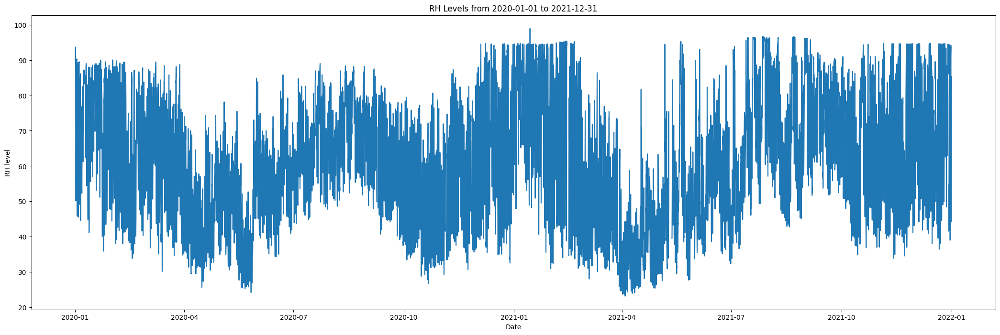

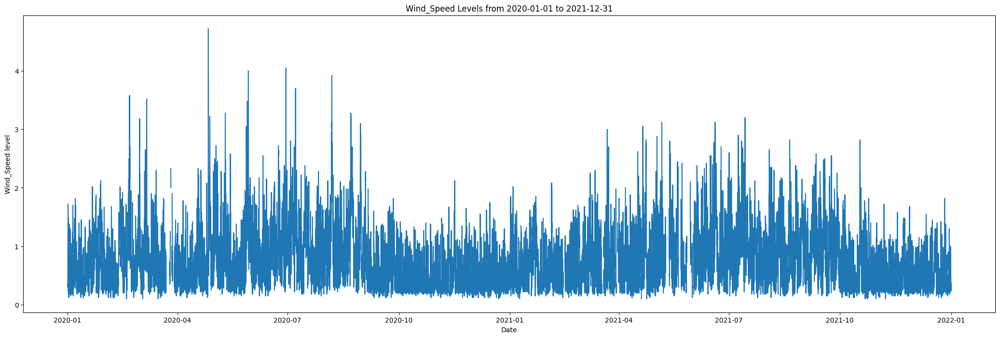

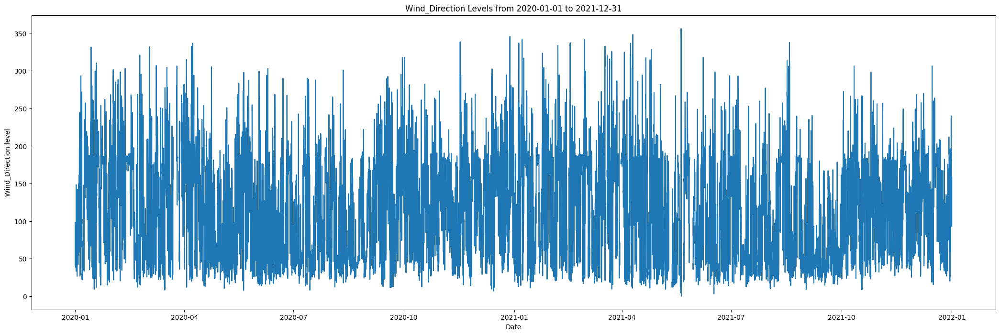

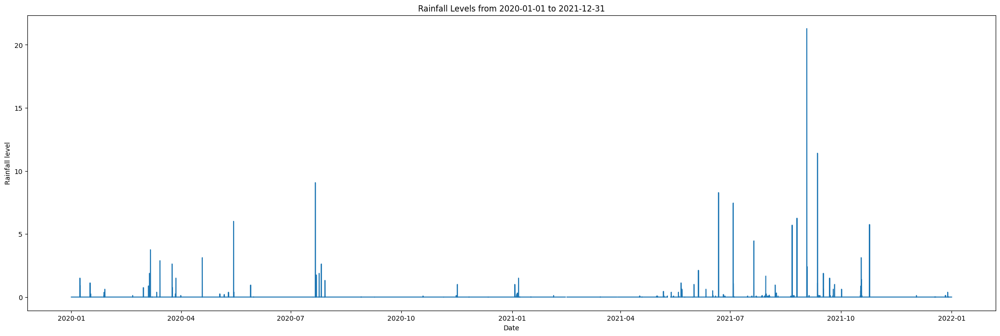

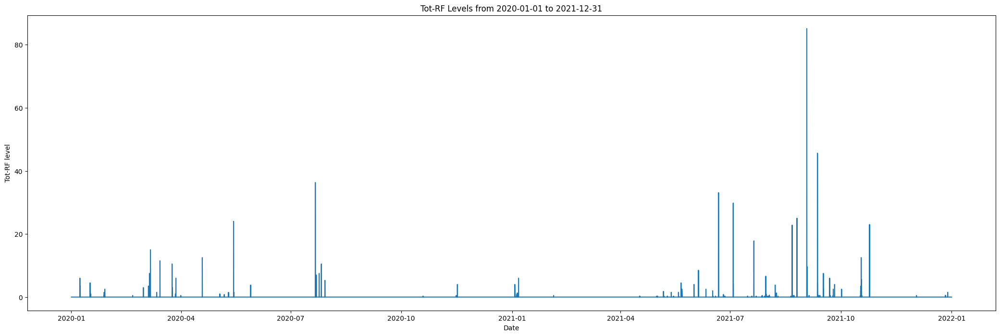

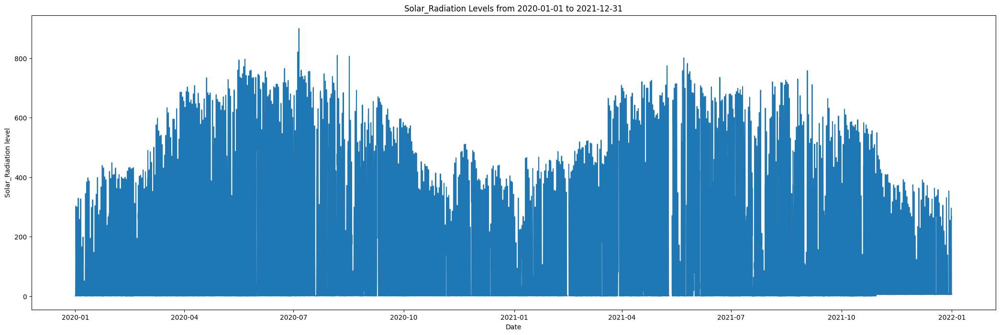

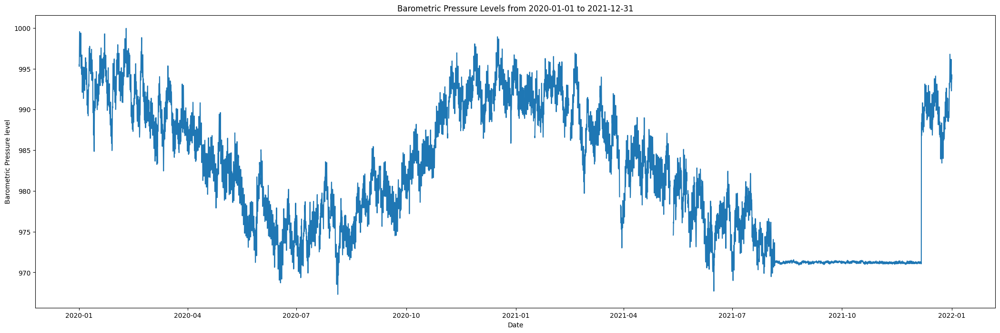

In [26]:
metero_list=['Temperature','RH','Wind_Speed','Wind_Direction','Rainfall','Tot-RF','Solar_Radiation','Barometric Pressure']
plot_columns(df,metero_list,'2020-01-01','2021-12-31')

## Plotting after resampling

In [27]:
def plot_columns_resampled(data,columnn,start_date,end_date,freq,agg_func):
    filtered_data=data[start_date:end_date]
    resampled_data=filtered_data.resample(freq).apply(agg_func)
    for col in columnn:
        if col in resampled_data.columns:
            plt.figure(figsize=(26,8))
            plt.plot(resampled_data.index,resampled_data[col])
            agg_name = agg_func if isinstance(agg_func, str) else agg_func.__name__ if hasattr(agg_func, '__name__') else 'Custom Function'
            plt.axvline(pd.to_datetime('2020-03-01'), color='red', linestyle='--', linewidth=2, label='Lockdown Starts')
            plt.title(f'{agg_name.capitalize()} {col} Levels from {start_date} to {end_date} (Resampled : {freq})')
            plt.xlabel('Date')
            plt.ylabel(f'{col} level ({agg_name.capitalize()})')
            plt.legend(loc='upper left')
            plt.grid(True)
            plt.show()
        else:
            print(f"Pollutant '{col}' not found in the dataset.")

C:\Users\arunendra\AppData\Local\Temp\ipykernel_8512\4102611645.py:3: FutureWarning: The provided callable <function mean at 0x0000014B984E0F40> is currently using DatetimeIndexResampler.mean. In a future version of pandas, the provided callable will be used directly. To keep current behavior pass the string "mean" instead.
  resampled_data=filtered_data.resample(freq).apply(agg_func)


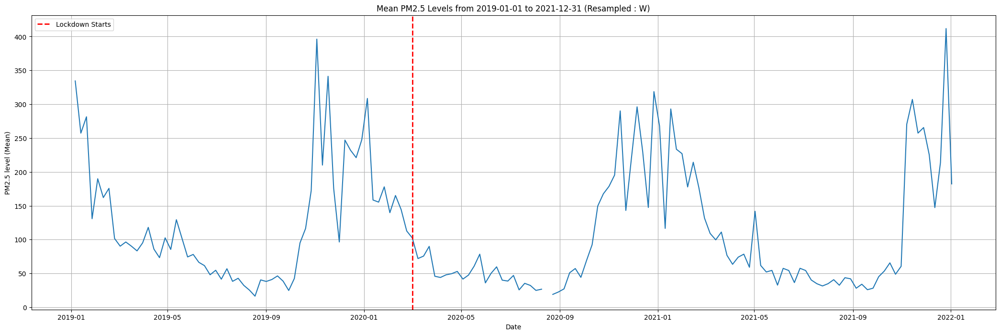

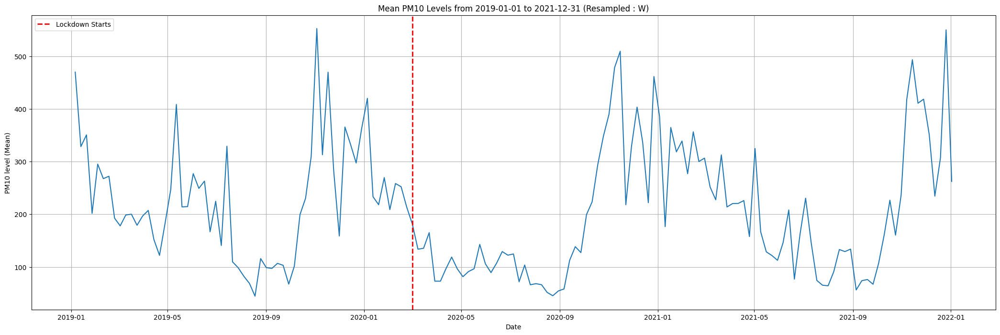

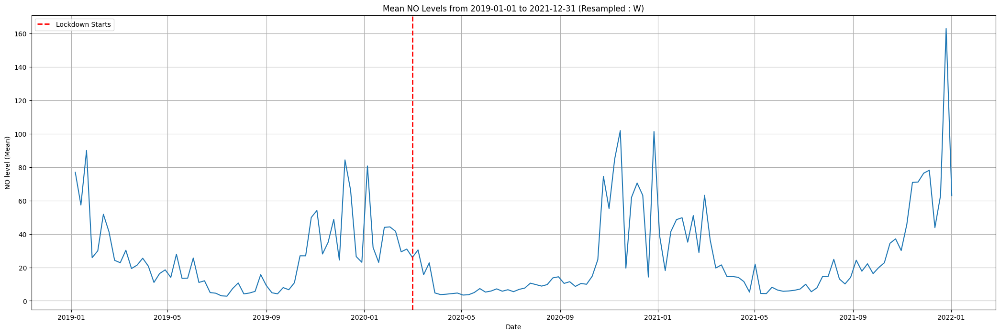

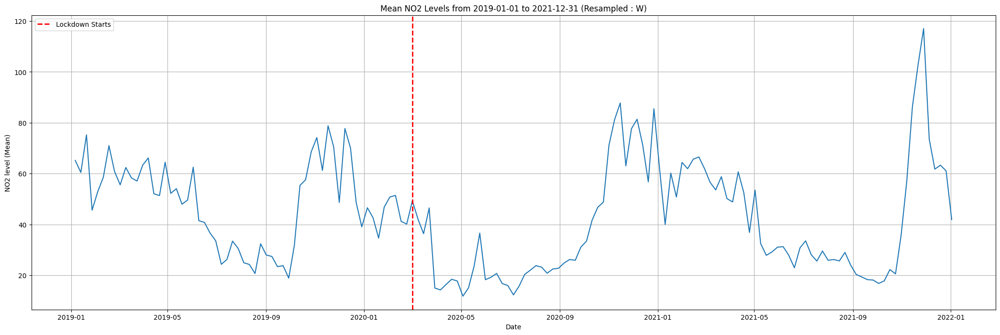

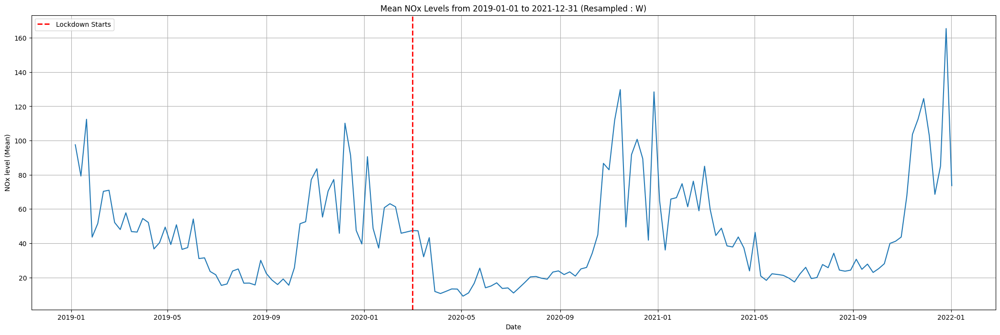

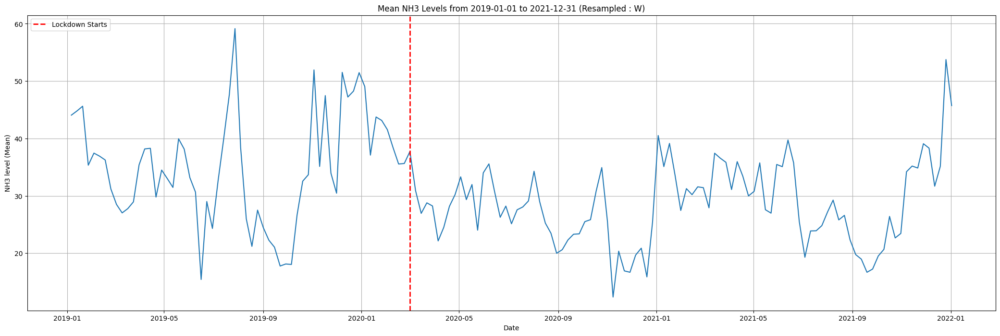

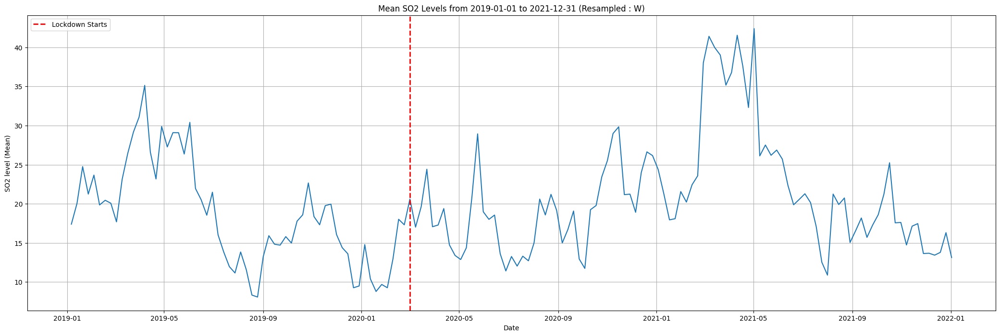

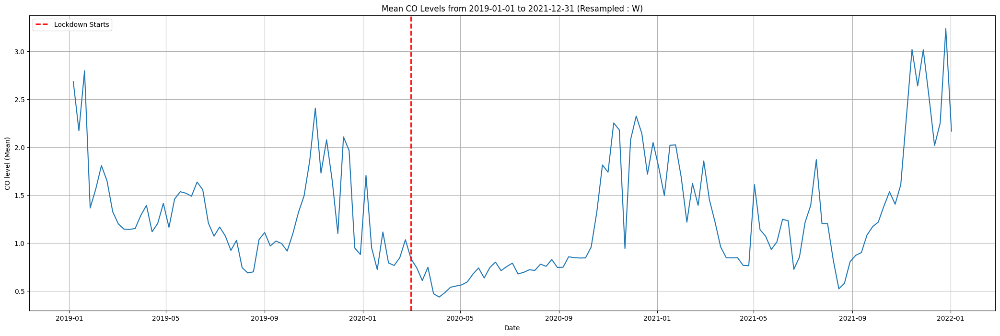

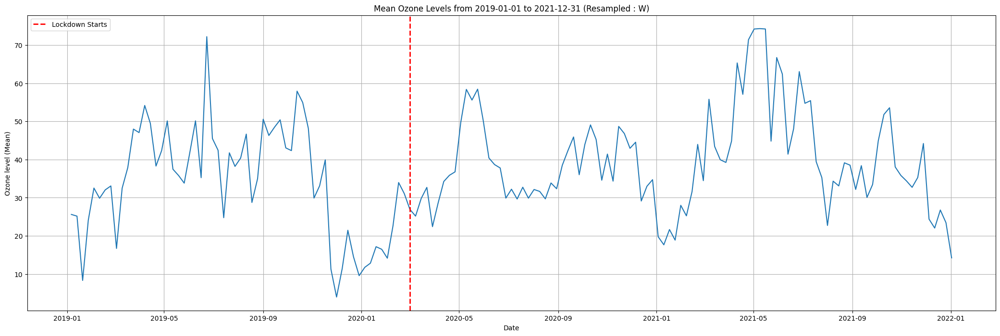

In [28]:
# Resampled Pollutants
pollutant_list=['PM2.5','PM10','NO','NO2','NOx','NH3','SO2','CO','Ozone']
plot_columns_resampled(df,pollutant_list,'2019-01-01','2021-12-31','W',agg_func=np.mean)

<Axes: xlabel='Datetime'>

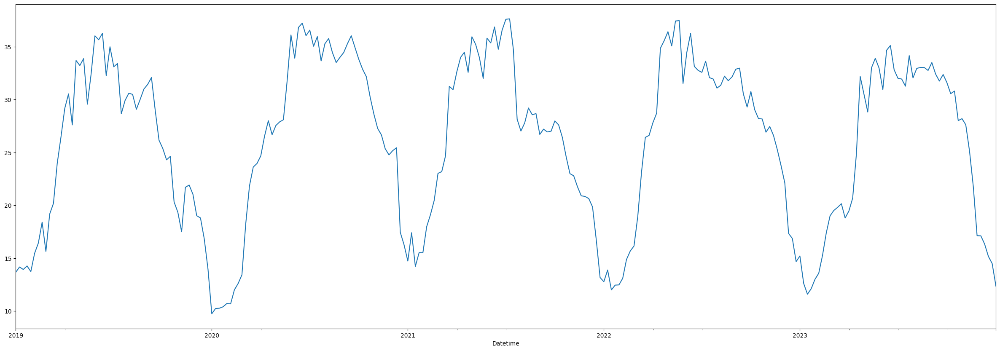

In [29]:
plt.figure(figsize=(30,10))
means=df['Temperature'].resample('W').mean()
means.plot()

<Axes: xlabel='Datetime'>

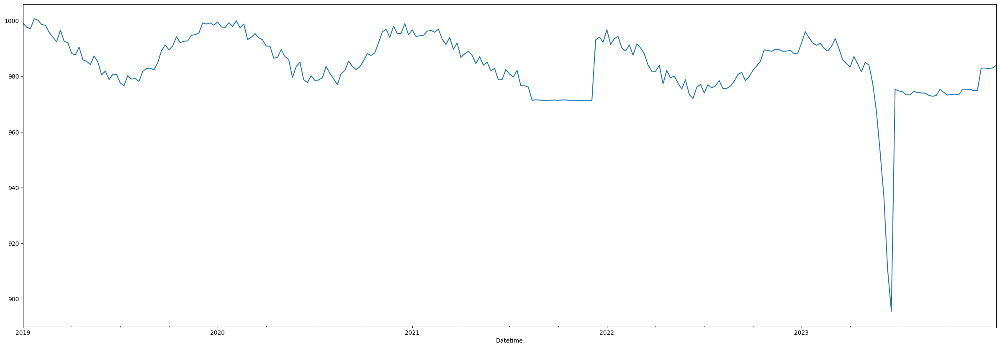

In [30]:
plt.figure(figsize=(30,10))
means=df['Barometric Pressure'].resample('W').max()
means.plot()

## 2020

C:\Users\arunendra\AppData\Local\Temp\ipykernel_8512\4102611645.py:3: FutureWarning: The provided callable <function mean at 0x0000014B984E0F40> is currently using DatetimeIndexResampler.mean. In a future version of pandas, the provided callable will be used directly. To keep current behavior pass the string "mean" instead.
  resampled_data=filtered_data.resample(freq).apply(agg_func)


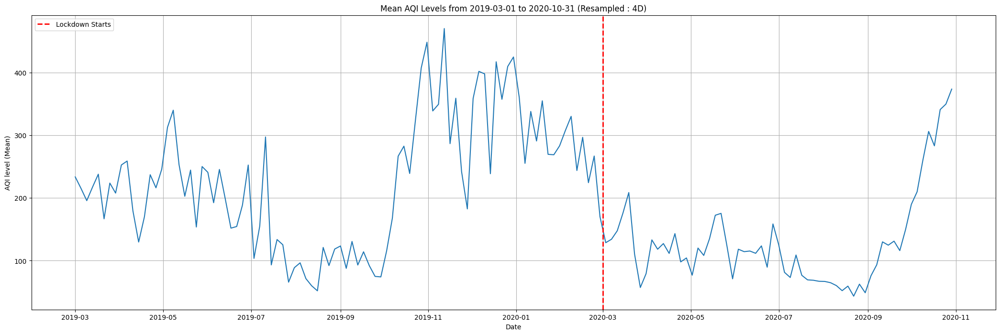

In [31]:
plot_columns_resampled(df,['AQI'],'2019-03-01','2020-10-31','4D',agg_func=np.mean)

# Visualising missing data

In [32]:
!pip install missingno

In [33]:
def missing_values_table(df):
        mis_val = df.isnull().sum()
        mis_val_percent = 100 * df.isnull().sum() / len(df)
        
        mis_val_table = pd.concat([mis_val, mis_val_percent], axis=1)
        
        mis_val_table_ren_columns = mis_val_table.rename(
        columns = {0 : 'Missing Values', 1 : '% of Total Values'})

        mis_val_table_ren_columns = mis_val_table_ren_columns[mis_val_table_ren_columns.iloc[:,1] != 0].sort_values('% of Total Values', ascending=False).round(1)
        
        print ("Your selected dataframe has " + str(df.shape[1]) + " columns.\n"      
            "There are " + str(mis_val_table_ren_columns.shape[0]) +
              " columns that have missing values.")
        
        # Return the dataframe with missing information
        return mis_val_table_ren_columns

missing_values= missing_values_table(df)
missing_values.style.background_gradient(cmap='Reds')

Your selected dataframe has 20 columns.
There are 19 columns that have missing values.


,Missing Values,% of Total Values
AQI,3849,8.800000
PM2.5,2632,6.000000
Benzene,2422,5.500000
CO,2401,5.500000
PM10,2111,4.800000
Ozone,2099,4.800000
NH3,2021,4.600000
Toluene,1684,3.800000
NO,1413,3.200000
Wind_Speed,1410,3.200000


<Axes: >

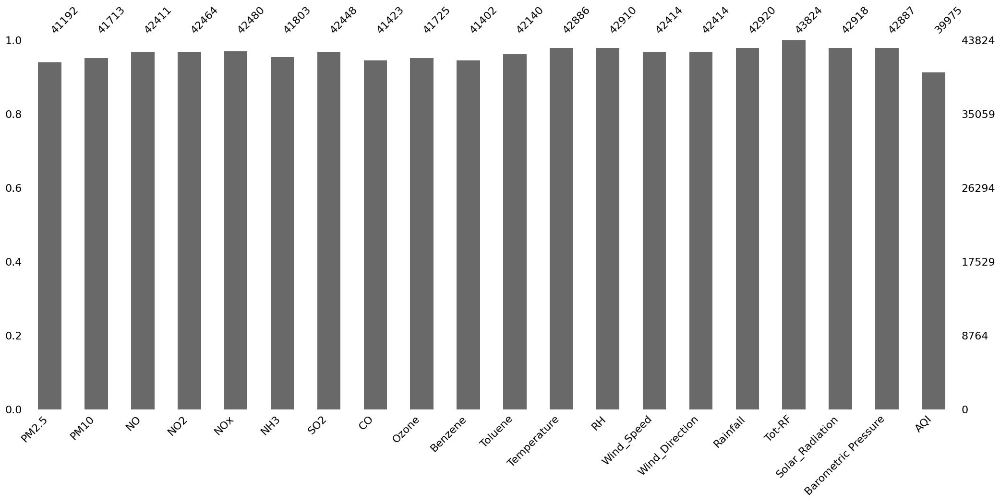

In [34]:
msno.bar(df)

<Axes: >

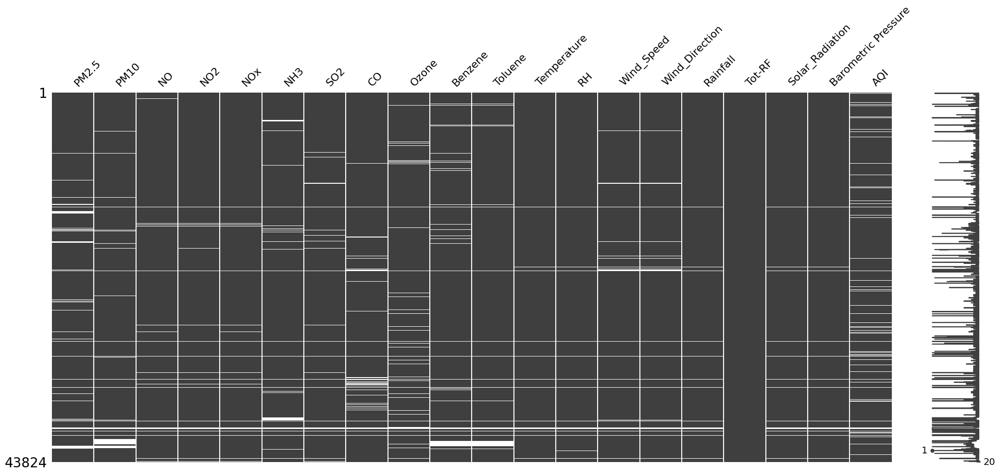

In [35]:
msno.matrix(df)

<Axes: >

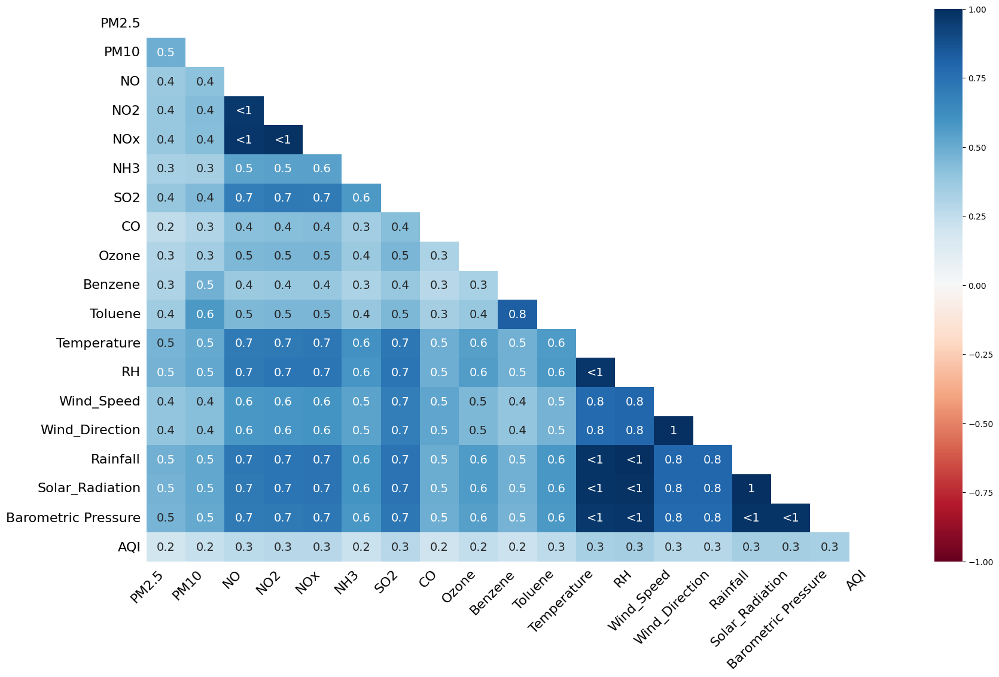

In [36]:
msno.heatmap(df)

<Axes: >

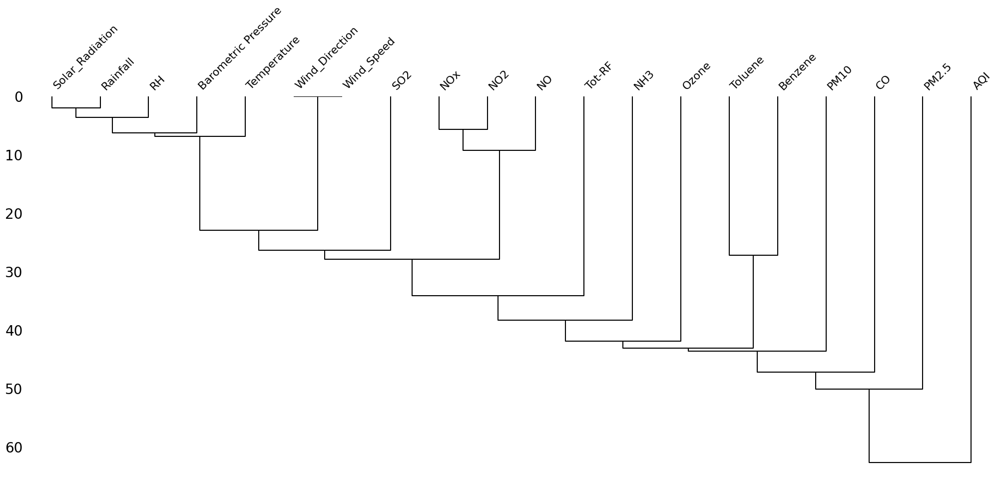

In [37]:
msno.dendrogram(df)

# Missing data handling tests

In [38]:
df

,PM2.5,PM10,NO,NO2,NOx,NH3,SO2,CO,Ozone,Benzene,Toluene,Temperature,RH,Wind_Speed,Wind_Direction,Rainfall,Tot-RF,Solar_Radiation,Barometric Pressure,AQI
Datetime,,,,,,,,,,,,,,,,,,,,
2019-01-01 00:00:00,408.25,567.25,248.030,146.600,279.880,43.200,20.880000,4.150000,2.100,11.900,57.070,9.450,91.020,0.200,138.900,0.0,0.0,1.030,996.40,486.0
2019-01-01 01:00:00,466.75,606.75,230.750,101.200,242.120,43.500,16.120000,4.750000,2.950,13.050,60.320,8.900,95.500,0.300,160.200,0.0,0.0,0.880,996.38,486.0
2019-01-01 02:00:00,496.00,663.25,179.600,80.950,189.100,37.550,14.850000,4.100000,1.900,13.220,63.750,8.620,97.230,0.280,145.150,0.0,0.0,1.000,996.18,500.0
2019-01-01 03:00:00,467.25,640.00,142.550,66.270,151.600,43.030,14.150000,3.680000,2.150,15.200,68.920,8.150,99.050,0.280,128.230,0.0,0.0,1.180,995.90,500.0
2019-01-01 04:00:00,453.25,615.50,92.870,56.630,105.920,42.000,12.400000,2.900000,1.900,15.800,66.900,7.600,99.400,0.250,113.400,0.0,0.0,1.250,995.20,500.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2023-12-31 19:00:00,230.50,425.25,6.850,32.175,39.025,59.425,7.533333,1.266667,2.575,0.800,2.075,11.575,83.000,1.025,59.800,0.0,0.0,5.250,983.00,410.0
2023-12-31 20:00:00,238.50,433.25,5.575,30.200,35.750,58.750,8.225000,1.325000,2.700,0.800,1.775,11.425,83.225,1.025,58.425,0.0,0.0,5.250,983.00,391.0
2023-12-31 21:00:00,233.00,417.50,5.625,26.550,32.200,57.875,7.650000,1.150000,2.650,0.725,1.725,11.200,83.425,1.000,59.125,0.0,0.0,5.425,983.10,401.0


In [39]:
df.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 43824 entries, 2019-01-01 00:00:00 to 2023-12-31 23:00:00
Data columns (total 20 columns):
 #   Column               Non-Null Count  Dtype  
---  ------               --------------  -----  
 0   PM2.5                41192 non-null  float64
 1   PM10                 41713 non-null  float64
 2   NO                   42411 non-null  float64
 3   NO2                  42464 non-null  float64
 4   NOx                  42480 non-null  float64
 5   NH3                  41803 non-null  float64
 6   SO2                  42448 non-null  float64
 7   CO                   41423 non-null  float64
 8   Ozone                41725 non-null  float64
 9   Benzene              41402 non-null  float64
 10  Toluene              42140 non-null  float64
 11  Temperature          42886 non-null  float64
 12  RH                   42910 non-null  float64
 13  Wind_Speed           42414 non-null  float64
 14  Wind_Direction       42414 non-null  float64
 15  R

In [40]:
df.isnull().any()

PM2.5                   True
PM10                    True
NO                      True
NO2                     True
NOx                     True
NH3                     True
SO2                     True
CO                      True
Ozone                   True
Benzene                 True
Toluene                 True
Temperature             True
RH                      True
Wind_Speed              True
Wind_Direction          True
Rainfall                True
Tot-RF                 False
Solar_Radiation         True
Barometric Pressure     True
AQI                     True
dtype: bool

In [41]:
df.isna().sum()

PM2.5                  2632
PM10                   2111
NO                     1413
NO2                    1360
NOx                    1344
NH3                    2021
SO2                    1376
CO                     2401
Ozone                  2099
Benzene                2422
Toluene                1684
Temperature             938
RH                      914
Wind_Speed             1410
Wind_Direction         1410
Rainfall                904
Tot-RF                    0
Solar_Radiation         906
Barometric Pressure     937
AQI                    3849
dtype: int64

In [42]:
df.query('Temperature!=Temperature')

,PM2.5,PM10,NO,NO2,NOx,NH3,SO2,CO,Ozone,Benzene,Toluene,Temperature,RH,Wind_Speed,Wind_Direction,Rainfall,Tot-RF,Solar_Radiation,Barometric Pressure,AQI
Datetime,,,,,,,,,,,,,,,,,,,,
2019-01-04 10:00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,368.0
2019-02-27 12:00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,103.0
2019-02-27 13:00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN
2019-02-27 14:00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN
2019-02-27 15:00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2023-12-14 05:00:00,157.25,268.75,NaN,NaN,NaN,NaN,NaN,0.8,NaN,0.175,0.1,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,325.0
2023-12-14 06:00:00,155.00,251.25,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.200,0.1,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,329.0
2023-12-14 07:00:00,NaN,303.75,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.200,0.1,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,327.0


In [43]:
# other column null where temperature is null
df.query('Temperature!=Temperature').count()

PM2.5                  178
PM10                   198
NO                     118
NO2                    119
NOx                    119
NH3                     85
SO2                    109
CO                     177
Ozone                  145
Benzene                195
Toluene                208
Temperature              0
RH                      35
Wind_Speed              35
Wind_Direction          35
Rainfall                35
Tot-RF                 938
Solar_Radiation         35
Barometric Pressure     35
AQI                    257
dtype: int64

In [44]:
# Where all PM2.5 is null
df[df['PM2.5'].isnull()]

,PM2.5,PM10,NO,NO2,NOx,NH3,SO2,CO,Ozone,Benzene,Toluene,Temperature,RH,Wind_Speed,Wind_Direction,Rainfall,Tot-RF,Solar_Radiation,Barometric Pressure,AQI
Datetime,,,,,,,,,,,,,,,,,,,,
2019-01-04 10:00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,368.0
2019-02-27 12:00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,103.0
2019-02-27 13:00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN
2019-02-27 14:00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN
2019-02-27 15:00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2023-12-25 07:00:00,NaN,325.25,30.675,32.275,62.925,75.875,3.000,0.833333,2.125,0.625,1.85,10.825,94.900,1.375,55.650,0.0,0.0,28.975,982.825,289.0
2023-12-25 08:00:00,NaN,346.50,35.325,37.400,72.675,67.050,4.675,1.600000,2.175,0.675,2.25,11.575,91.675,1.450,56.875,0.0,0.0,112.275,982.850,273.0
2023-12-25 09:00:00,NaN,393.25,28.375,53.575,81.950,68.325,4.825,1.425000,2.500,0.750,2.30,12.900,85.025,1.500,59.000,0.0,0.0,183.325,982.825,282.0


In [45]:
# Finding if correlation with itself
df_test=df.copy()
df_test=df_test.dropna()

In [46]:
df_test.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 32187 entries, 2019-01-01 00:00:00 to 2023-12-31 23:00:00
Data columns (total 20 columns):
 #   Column               Non-Null Count  Dtype  
---  ------               --------------  -----  
 0   PM2.5                32187 non-null  float64
 1   PM10                 32187 non-null  float64
 2   NO                   32187 non-null  float64
 3   NO2                  32187 non-null  float64
 4   NOx                  32187 non-null  float64
 5   NH3                  32187 non-null  float64
 6   SO2                  32187 non-null  float64
 7   CO                   32187 non-null  float64
 8   Ozone                32187 non-null  float64
 9   Benzene              32187 non-null  float64
 10  Toluene              32187 non-null  float64
 11  Temperature          32187 non-null  float64
 12  RH                   32187 non-null  float64
 13  Wind_Speed           32187 non-null  float64
 14  Wind_Direction       32187 non-null  float64
 15  R

<Axes: xlabel='Lag', ylabel='Autocorrelation'>

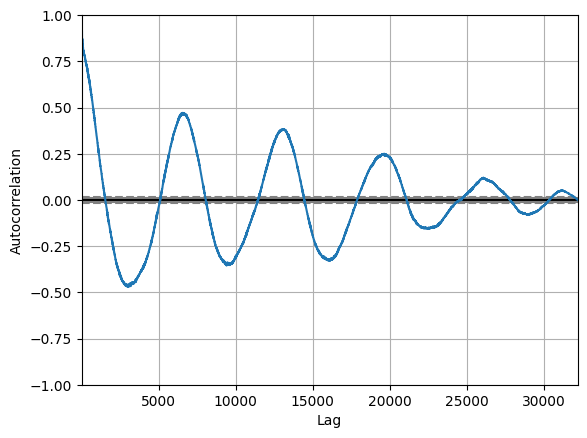

In [47]:
pd.plotting.autocorrelation_plot(df_test['2019':'2023']['Temperature'])

<Axes: xlabel='y(t)', ylabel='y(t + 3)'>

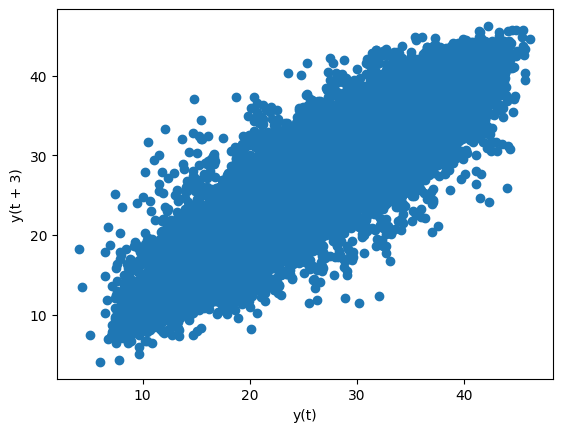

In [48]:
pd.plotting.lag_plot(df_test['Temperature'], lag=3)

<Axes: xlabel='y(t)', ylabel='y(t + 24)'>

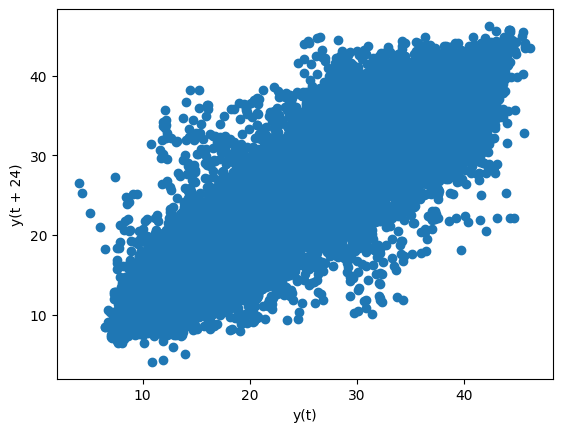

In [49]:
pd.plotting.lag_plot(df_test['Temperature'], lag=24)

<Axes: xlabel='y(t)', ylabel='y(t + 8640)'>

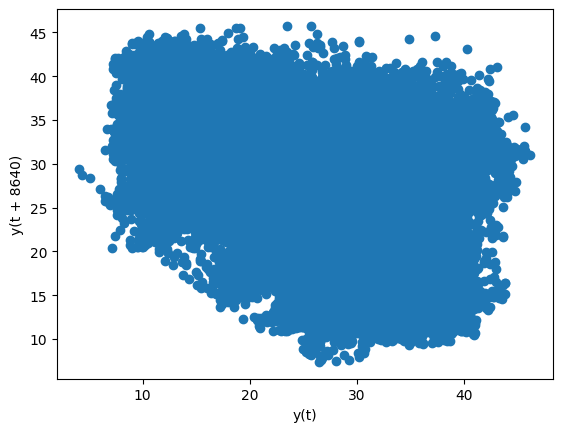

In [50]:
pd.plotting.lag_plot(df_test['Temperature'], lag=8640)

In [51]:
df_temp_imp=df.copy()


## Forward Fill

In [52]:
df_temp_imp['tempf']=df_temp_imp['Temperature'].fillna(method='ffill')
df_temp_imp['2019-01-04':'2019-01-05']['tempf']

C:\Users\arunendra\AppData\Local\Temp\ipykernel_8512\2100876144.py:1: FutureWarning: Series.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  df_temp_imp['tempf']=df_temp_imp['Temperature'].fillna(method='ffill')


Datetime
2019-01-04 00:00:00    11.62
2019-01-04 01:00:00    11.05
2019-01-04 02:00:00     9.60
2019-01-04 03:00:00     8.80
2019-01-04 04:00:00     8.87
2019-01-04 05:00:00     8.95
2019-01-04 06:00:00     8.72
2019-01-04 07:00:00     8.78
2019-01-04 08:00:00    10.07
2019-01-04 09:00:00    11.40
2019-01-04 10:00:00    11.40
2019-01-04 11:00:00    15.42
2019-01-04 12:00:00    17.03
2019-01-04 13:00:00    17.35
2019-01-04 14:00:00    17.00
2019-01-04 15:00:00    16.22
2019-01-04 16:00:00    15.40
2019-01-04 17:00:00    13.85
2019-01-04 18:00:00    12.95
2019-01-04 19:00:00    12.53
2019-01-04 20:00:00    12.18
2019-01-04 21:00:00    11.93
2019-01-04 22:00:00    10.95
2019-01-04 23:00:00    10.32
2019-01-05 00:00:00    10.92
2019-01-05 01:00:00    10.70
2019-01-05 02:00:00    10.60
2019-01-05 03:00:00    10.35
2019-01-05 04:00:00    10.28
2019-01-05 05:00:00    10.00
2019-01-05 06:00:00     9.83
2019-01-05 07:00:00     9.62
2019-01-05 08:00:00    11.92
2019-01-05 09:00:00    14.27
2019-

In [53]:
df['2019-01-04':'2019-01-05']

,PM2.5,PM10,NO,NO2,NOx,NH3,SO2,CO,Ozone,Benzene,Toluene,Temperature,RH,Wind_Speed,Wind_Direction,Rainfall,Tot-RF,Solar_Radiation,Barometric Pressure,AQI
Datetime,,,,,,,,,,,,,,,,,,,,
2019-01-04 00:00:00,342.00,406.50,3.60,49.70,29.35,42.40,12.45,1.95,4.73,8.67,39.45,11.62,95.60,0.80,175.65,0.0,0.0,0.63,996.52,472.0
2019-01-04 01:00:00,337.50,408.00,1.97,40.25,23.00,46.35,11.97,1.90,5.05,9.03,66.32,11.05,98.23,0.75,175.05,0.0,0.0,0.63,996.25,457.0
2019-01-04 02:00:00,334.00,404.00,1.90,32.80,18.95,40.25,10.00,1.70,3.27,8.97,45.52,9.60,99.20,1.05,178.88,0.0,0.0,0.60,996.12,453.0
2019-01-04 03:00:00,288.50,355.50,13.85,39.70,32.42,39.18,10.75,1.60,2.97,8.02,39.28,8.80,99.40,0.48,144.48,0.0,0.0,0.83,995.60,452.0
2019-01-04 04:00:00,223.50,282.00,10.17,36.28,27.65,38.07,10.53,1.42,4.05,7.12,27.25,8.87,99.40,0.75,185.55,0.0,0.0,0.58,995.52,449.0
2019-01-04 05:00:00,190.00,259.50,2.72,27.45,16.82,39.50,10.25,1.40,5.15,6.62,27.73,8.95,99.40,1.27,182.45,0.0,0.0,0.50,995.75,397.0
2019-01-04 06:00:00,177.00,259.50,6.38,32.28,22.30,39.78,10.42,1.45,3.87,6.20,22.73,8.72,99.40,1.15,181.70,0.0,0.0,1.03,995.80,362.0
2019-01-04 07:00:00,190.50,270.00,27.13,41.78,44.35,39.38,10.67,1.63,2.22,6.43,25.87,8.78,99.40,0.38,118.38,0.0,0.0,22.95,996.20,345.0
2019-01-04 08:00:00,207.00,304.50,24.57,46.65,45.02,38.57,10.53,1.75,4.37,6.98,25.25,10.07,95.98,0.83,176.62,0.0,0.0,68.57,997.08,342.0


## Backward Fill

In [54]:
df_temp_imp['tempb']=df_temp_imp['Temperature'].fillna(method='bfill')
df_temp_imp['2019-01-04':'2019-01-05']['tempb']

C:\Users\arunendra\AppData\Local\Temp\ipykernel_8512\2265075768.py:1: FutureWarning: Series.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  df_temp_imp['tempb']=df_temp_imp['Temperature'].fillna(method='bfill')


Datetime
2019-01-04 00:00:00    11.62
2019-01-04 01:00:00    11.05
2019-01-04 02:00:00     9.60
2019-01-04 03:00:00     8.80
2019-01-04 04:00:00     8.87
2019-01-04 05:00:00     8.95
2019-01-04 06:00:00     8.72
2019-01-04 07:00:00     8.78
2019-01-04 08:00:00    10.07
2019-01-04 09:00:00    11.40
2019-01-04 10:00:00    15.42
2019-01-04 11:00:00    15.42
2019-01-04 12:00:00    17.03
2019-01-04 13:00:00    17.35
2019-01-04 14:00:00    17.00
2019-01-04 15:00:00    16.22
2019-01-04 16:00:00    15.40
2019-01-04 17:00:00    13.85
2019-01-04 18:00:00    12.95
2019-01-04 19:00:00    12.53
2019-01-04 20:00:00    12.18
2019-01-04 21:00:00    11.93
2019-01-04 22:00:00    10.95
2019-01-04 23:00:00    10.32
2019-01-05 00:00:00    10.92
2019-01-05 01:00:00    10.70
2019-01-05 02:00:00    10.60
2019-01-05 03:00:00    10.35
2019-01-05 04:00:00    10.28
2019-01-05 05:00:00    10.00
2019-01-05 06:00:00     9.83
2019-01-05 07:00:00     9.62
2019-01-05 08:00:00    11.92
2019-01-05 09:00:00    14.27
2019-

## Rolling Window Fill

In [55]:
df_temp_imp['tempr']=df_temp_imp['Temperature'].rolling(window=2,min_periods=1).mean()
df_temp_imp['2019-01-04':'2019-01-05']['tempr']

Datetime
2019-01-04 00:00:00    11.650
2019-01-04 01:00:00    11.335
2019-01-04 02:00:00    10.325
2019-01-04 03:00:00     9.200
2019-01-04 04:00:00     8.835
2019-01-04 05:00:00     8.910
2019-01-04 06:00:00     8.835
2019-01-04 07:00:00     8.750
2019-01-04 08:00:00     9.425
2019-01-04 09:00:00    10.735
2019-01-04 10:00:00    11.400
2019-01-04 11:00:00    15.420
2019-01-04 12:00:00    16.225
2019-01-04 13:00:00    17.190
2019-01-04 14:00:00    17.175
2019-01-04 15:00:00    16.610
2019-01-04 16:00:00    15.810
2019-01-04 17:00:00    14.625
2019-01-04 18:00:00    13.400
2019-01-04 19:00:00    12.740
2019-01-04 20:00:00    12.355
2019-01-04 21:00:00    12.055
2019-01-04 22:00:00    11.440
2019-01-04 23:00:00    10.635
2019-01-05 00:00:00    10.620
2019-01-05 01:00:00    10.810
2019-01-05 02:00:00    10.650
2019-01-05 03:00:00    10.475
2019-01-05 04:00:00    10.315
2019-01-05 05:00:00    10.140
2019-01-05 06:00:00     9.915
2019-01-05 07:00:00     9.725
2019-01-05 08:00:00    10.770
2

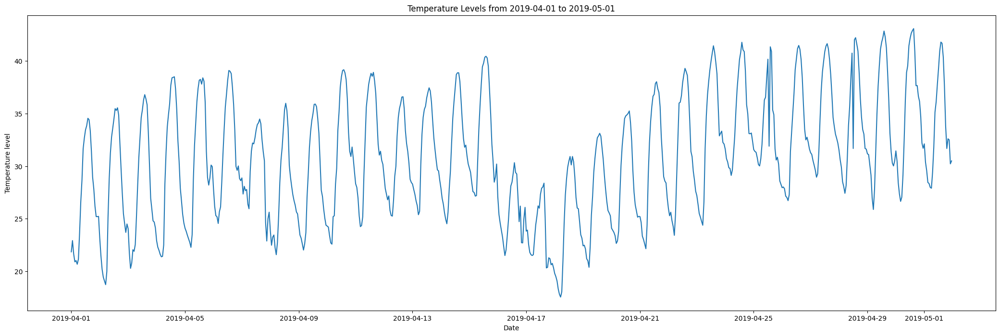

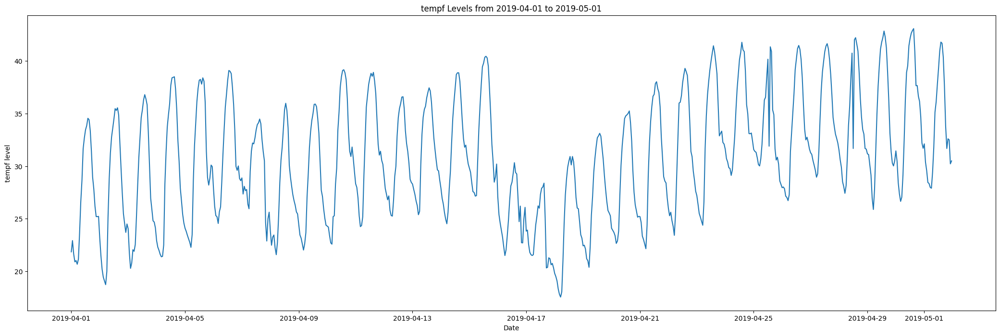

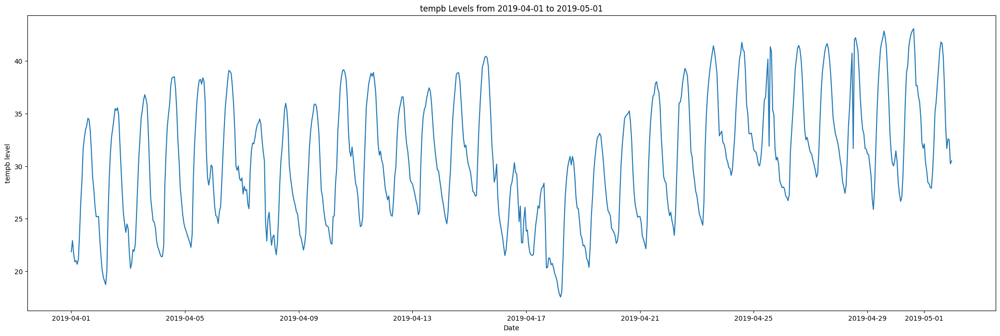

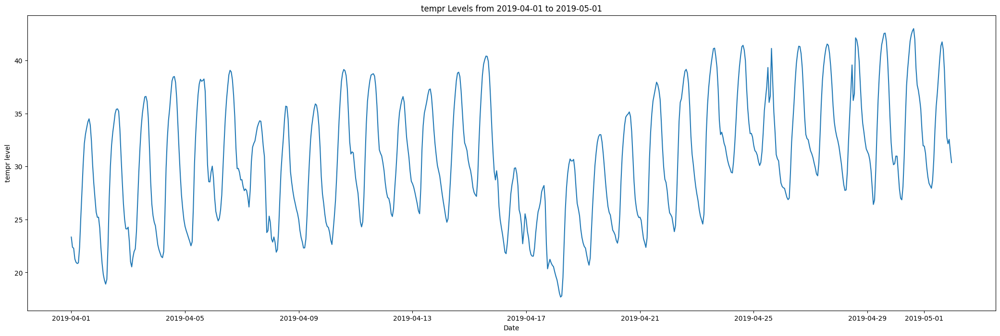

In [56]:
pollutant_list=['Temperature','tempf','tempb','tempr']
plot_columns(df_temp_imp,pollutant_list,'2019-04-01','2019-05-01')

# Kaggle imputations

## Imputing with a constant

In [57]:
from sklearn.impute import SimpleImputer
df_const=df.copy()

In [58]:
impute=SimpleImputer(strategy='constant')
df_const.iloc[:,:]=impute.fit_transform(df_const)
df_const.isna().sum()

PM2.5                  0
PM10                   0
NO                     0
NO2                    0
NOx                    0
NH3                    0
SO2                    0
CO                     0
Ozone                  0
Benzene                0
Toluene                0
Temperature            0
RH                     0
Wind_Speed             0
Wind_Direction         0
Rainfall               0
Tot-RF                 0
Solar_Radiation        0
Barometric Pressure    0
AQI                    0
dtype: int64

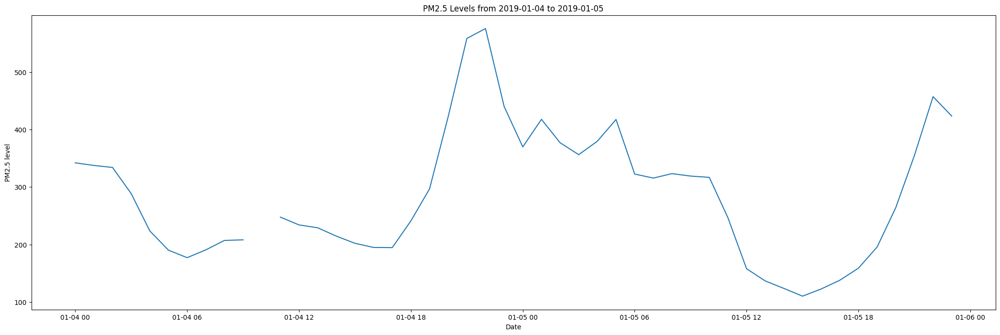

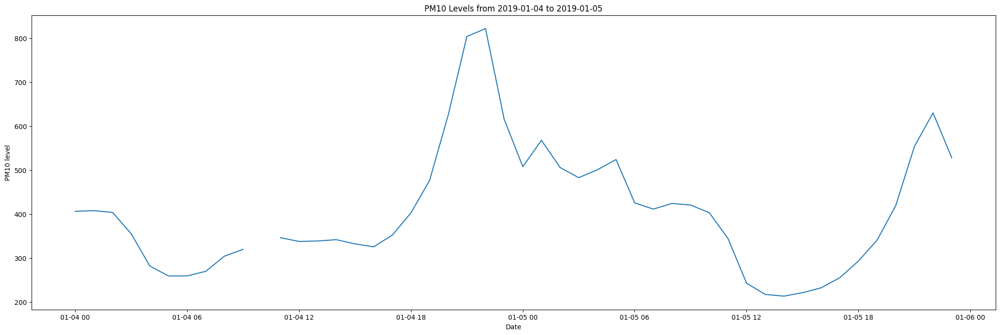

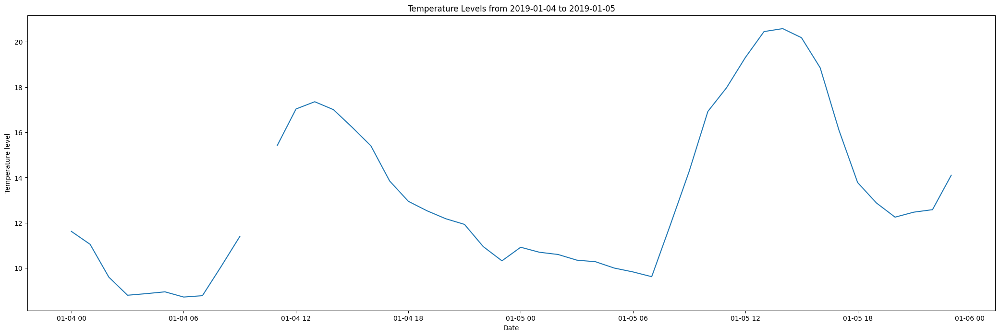

In [59]:
pollutant_list=['PM2.5','PM10','Temperature']
plot_columns(df,pollutant_list,'2019-01-04','2019-01-05')

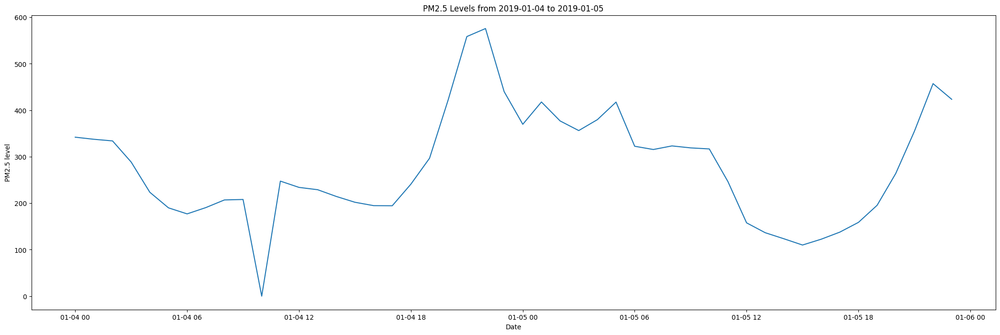

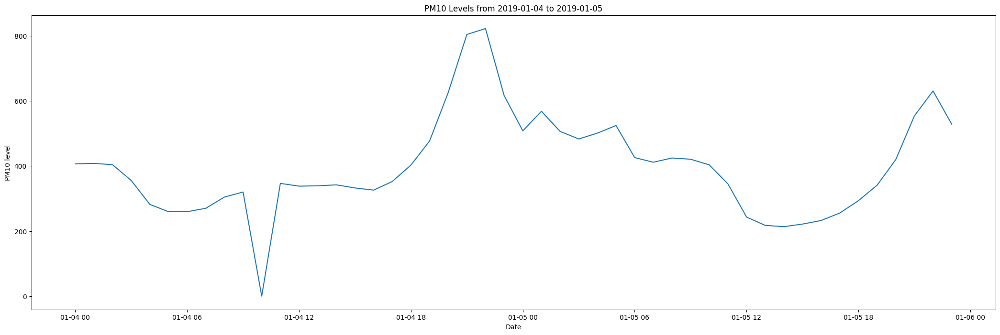

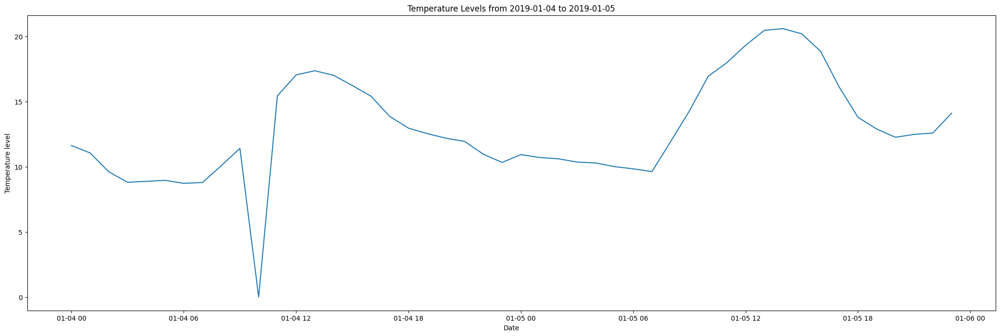

In [60]:
pollutant_list=['PM2.5','PM10','Temperature']
plot_columns(df_const,pollutant_list,'2019-01-04','2019-01-05')

## Imputing with mean

In [61]:
from sklearn.impute import SimpleImputer
df_mean=df.copy()

In [62]:
impute_mean=SimpleImputer(strategy='mean')
df_mean.iloc[:,:]=impute_mean.fit_transform(df_mean)
df_mean.isna().sum()

PM2.5                  0
PM10                   0
NO                     0
NO2                    0
NOx                    0
NH3                    0
SO2                    0
CO                     0
Ozone                  0
Benzene                0
Toluene                0
Temperature            0
RH                     0
Wind_Speed             0
Wind_Direction         0
Rainfall               0
Tot-RF                 0
Solar_Radiation        0
Barometric Pressure    0
AQI                    0
dtype: int64

In [63]:
df_mean['2019-01-04':'2019-01-05']['Temperature']

Datetime
2019-01-04 00:00:00    11.62000
2019-01-04 01:00:00    11.05000
2019-01-04 02:00:00     9.60000
2019-01-04 03:00:00     8.80000
2019-01-04 04:00:00     8.87000
2019-01-04 05:00:00     8.95000
2019-01-04 06:00:00     8.72000
2019-01-04 07:00:00     8.78000
2019-01-04 08:00:00    10.07000
2019-01-04 09:00:00    11.40000
2019-01-04 10:00:00    26.08288
2019-01-04 11:00:00    15.42000
2019-01-04 12:00:00    17.03000
2019-01-04 13:00:00    17.35000
2019-01-04 14:00:00    17.00000
2019-01-04 15:00:00    16.22000
2019-01-04 16:00:00    15.40000
2019-01-04 17:00:00    13.85000
2019-01-04 18:00:00    12.95000
2019-01-04 19:00:00    12.53000
2019-01-04 20:00:00    12.18000
2019-01-04 21:00:00    11.93000
2019-01-04 22:00:00    10.95000
2019-01-04 23:00:00    10.32000
2019-01-05 00:00:00    10.92000
2019-01-05 01:00:00    10.70000
2019-01-05 02:00:00    10.60000
2019-01-05 03:00:00    10.35000
2019-01-05 04:00:00    10.28000
2019-01-05 05:00:00    10.00000
2019-01-05 06:00:00     9.83000

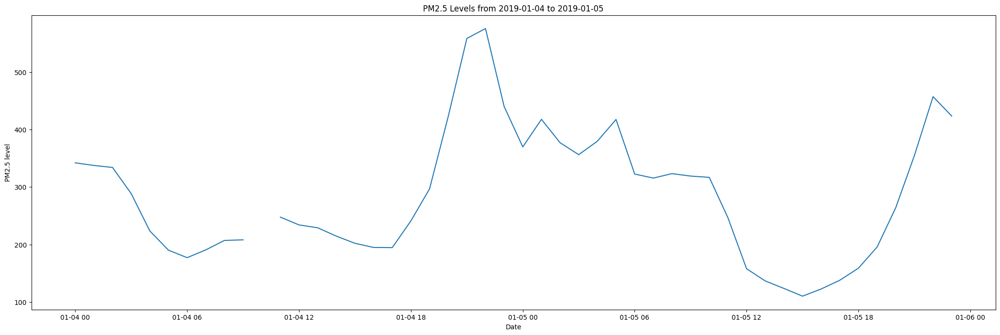

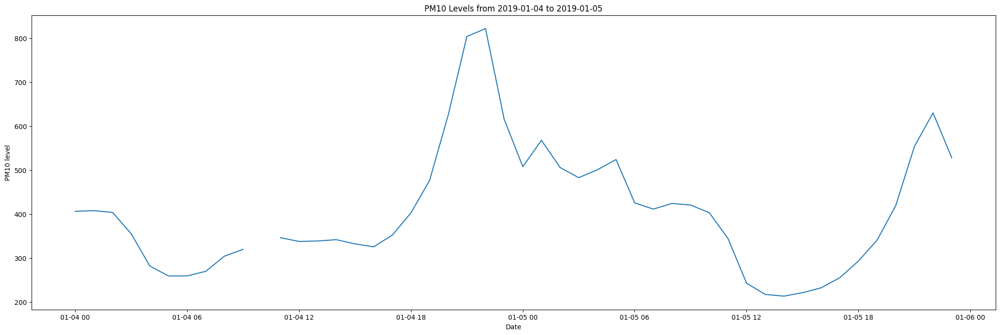

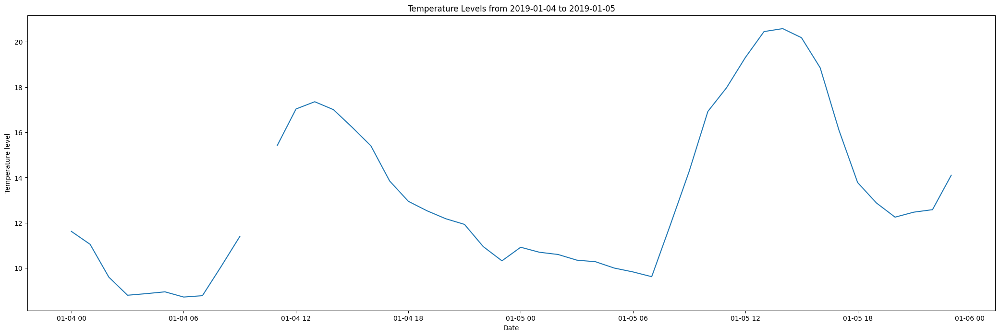

In [64]:
pollutant_list=['PM2.5','PM10','Temperature']
plot_columns(df,pollutant_list,'2019-01-04','2019-01-05')

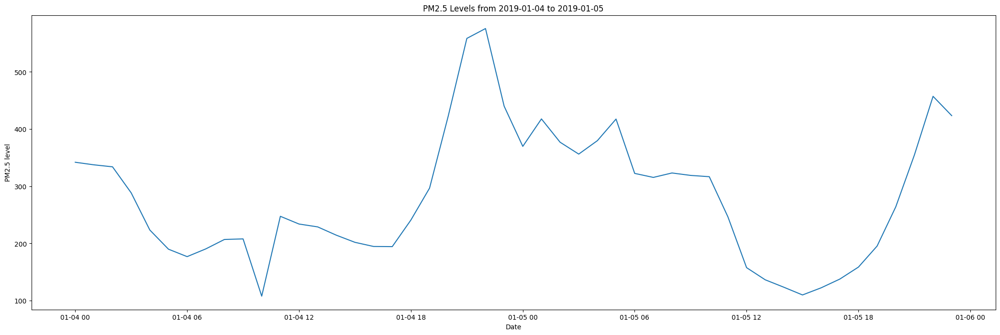

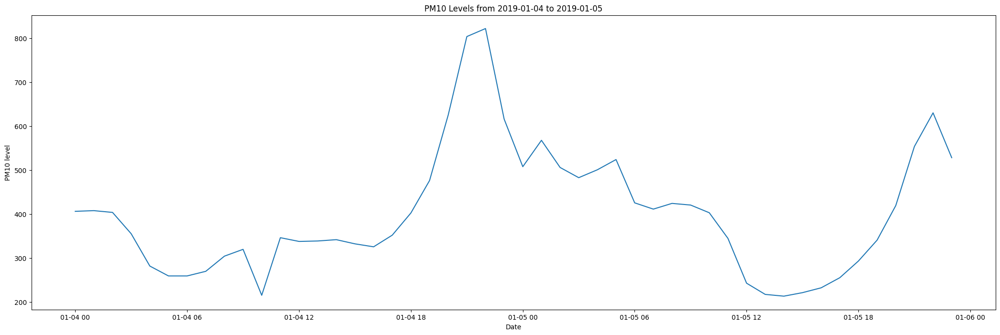

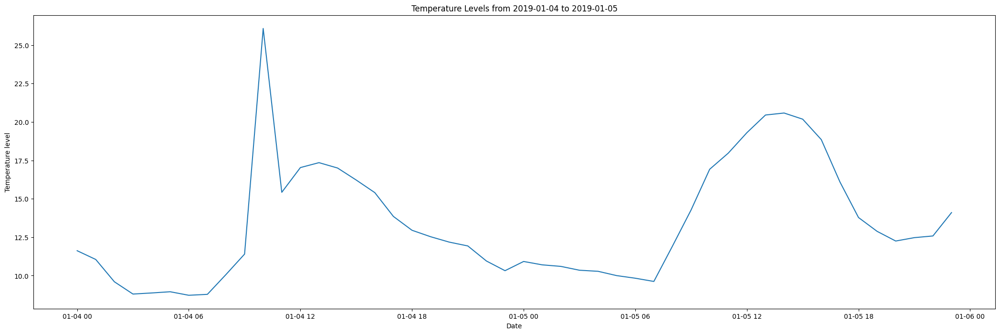

In [65]:
pollutant_list=['PM2.5','PM10','Temperature']
plot_columns(df_mean,pollutant_list,'2019-01-04','2019-01-05')

## Time series imputation

In [66]:
df_missing= missing_values_table(df)
df_missing.style.background_gradient(cmap='Reds')

Your selected dataframe has 20 columns.
There are 19 columns that have missing values.


,Missing Values,% of Total Values
AQI,3849,8.800000
PM2.5,2632,6.000000
Benzene,2422,5.500000
CO,2401,5.500000
PM10,2111,4.800000
Ozone,2099,4.800000
NH3,2021,4.600000
Toluene,1684,3.800000
NO,1413,3.200000
Wind_Speed,1410,3.200000


### Imputing using forward fill

In [67]:
df_for=df.copy()

In [68]:
df_for['Temperature']=df_for['Temperature'].fillna(method='ffill')

C:\Users\arunendra\AppData\Local\Temp\ipykernel_8512\398519489.py:1: FutureWarning: Series.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  df_for['Temperature']=df_for['Temperature'].fillna(method='ffill')


In [69]:
df_for['2019-01-04':'2019-01-05']['Temperature']

Datetime
2019-01-04 00:00:00    11.62
2019-01-04 01:00:00    11.05
2019-01-04 02:00:00     9.60
2019-01-04 03:00:00     8.80
2019-01-04 04:00:00     8.87
2019-01-04 05:00:00     8.95
2019-01-04 06:00:00     8.72
2019-01-04 07:00:00     8.78
2019-01-04 08:00:00    10.07
2019-01-04 09:00:00    11.40
2019-01-04 10:00:00    11.40
2019-01-04 11:00:00    15.42
2019-01-04 12:00:00    17.03
2019-01-04 13:00:00    17.35
2019-01-04 14:00:00    17.00
2019-01-04 15:00:00    16.22
2019-01-04 16:00:00    15.40
2019-01-04 17:00:00    13.85
2019-01-04 18:00:00    12.95
2019-01-04 19:00:00    12.53
2019-01-04 20:00:00    12.18
2019-01-04 21:00:00    11.93
2019-01-04 22:00:00    10.95
2019-01-04 23:00:00    10.32
2019-01-05 00:00:00    10.92
2019-01-05 01:00:00    10.70
2019-01-05 02:00:00    10.60
2019-01-05 03:00:00    10.35
2019-01-05 04:00:00    10.28
2019-01-05 05:00:00    10.00
2019-01-05 06:00:00     9.83
2019-01-05 07:00:00     9.62
2019-01-05 08:00:00    11.92
2019-01-05 09:00:00    14.27
2019-

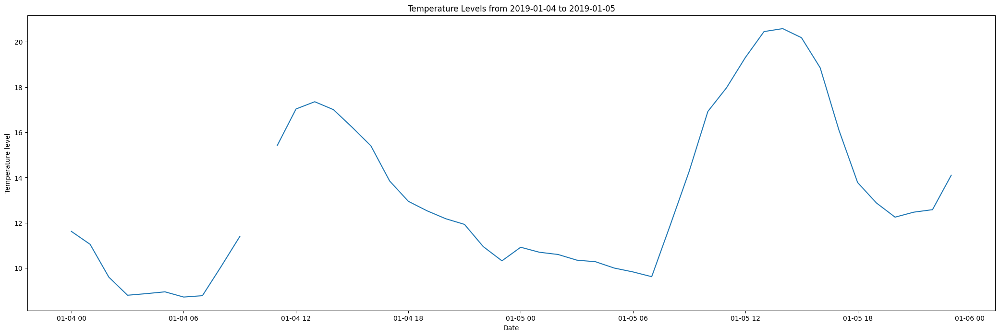

In [70]:
pollutant_list=['Temperature']
plot_columns(df,pollutant_list,'2019-01-04','2019-01-05')

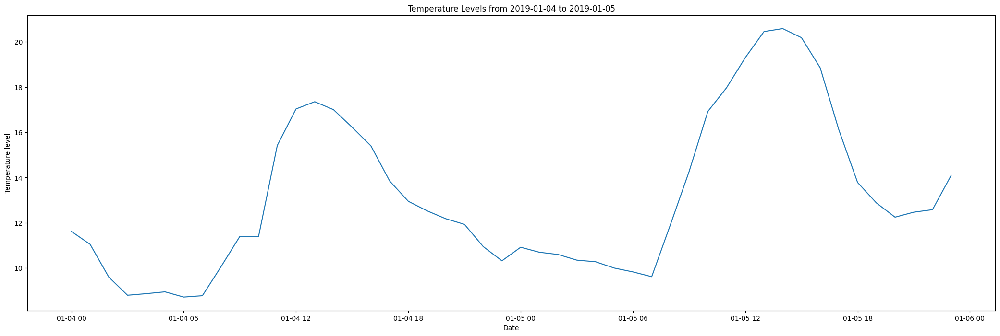

In [71]:
pollutant_list=['Temperature']
plot_columns(df_for,pollutant_list,'2019-01-04','2019-01-05')

### Imputation using backward fill

In [72]:
df_back=df.copy()

In [73]:
df_back['Temperature']=df_back['Temperature'].fillna(method='bfill')
df_back['2019-01-04':'2019-01-05']['Temperature']

C:\Users\arunendra\AppData\Local\Temp\ipykernel_8512\3627772203.py:1: FutureWarning: Series.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  df_back['Temperature']=df_back['Temperature'].fillna(method='bfill')


Datetime
2019-01-04 00:00:00    11.62
2019-01-04 01:00:00    11.05
2019-01-04 02:00:00     9.60
2019-01-04 03:00:00     8.80
2019-01-04 04:00:00     8.87
2019-01-04 05:00:00     8.95
2019-01-04 06:00:00     8.72
2019-01-04 07:00:00     8.78
2019-01-04 08:00:00    10.07
2019-01-04 09:00:00    11.40
2019-01-04 10:00:00    15.42
2019-01-04 11:00:00    15.42
2019-01-04 12:00:00    17.03
2019-01-04 13:00:00    17.35
2019-01-04 14:00:00    17.00
2019-01-04 15:00:00    16.22
2019-01-04 16:00:00    15.40
2019-01-04 17:00:00    13.85
2019-01-04 18:00:00    12.95
2019-01-04 19:00:00    12.53
2019-01-04 20:00:00    12.18
2019-01-04 21:00:00    11.93
2019-01-04 22:00:00    10.95
2019-01-04 23:00:00    10.32
2019-01-05 00:00:00    10.92
2019-01-05 01:00:00    10.70
2019-01-05 02:00:00    10.60
2019-01-05 03:00:00    10.35
2019-01-05 04:00:00    10.28
2019-01-05 05:00:00    10.00
2019-01-05 06:00:00     9.83
2019-01-05 07:00:00     9.62
2019-01-05 08:00:00    11.92
2019-01-05 09:00:00    14.27
2019-

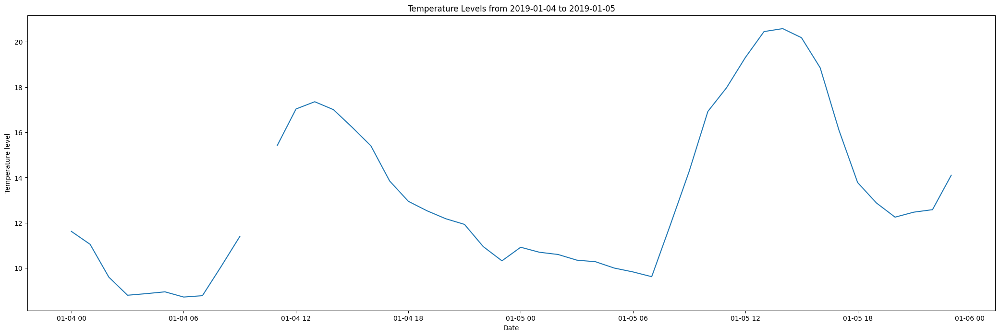

In [74]:
pollutant_list=['Temperature']
plot_columns(df,pollutant_list,'2019-01-04','2019-01-05')

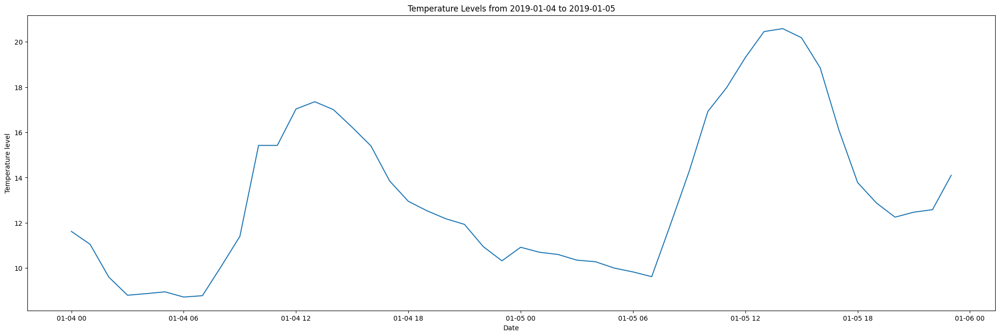

In [75]:
pollutant_list=['Temperature']
plot_columns(df_back,pollutant_list,'2019-01-04','2019-01-05')

### Imputation using Linear Interpolation

In [76]:
df_interpol=df.copy()

In [77]:
df_interpol['Temperature'].interpolate(limit_direction="both", inplace=True)

C:\Users\arunendra\AppData\Local\Temp\ipykernel_8512\2412012621.py:1: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  df_interpol['Temperature'].interpolate(limit_direction="both", inplace=True)


In [78]:
df_interpol['2019-01-04':'2019-01-05']['Temperature']

Datetime
2019-01-04 00:00:00    11.62
2019-01-04 01:00:00    11.05
2019-01-04 02:00:00     9.60
2019-01-04 03:00:00     8.80
2019-01-04 04:00:00     8.87
2019-01-04 05:00:00     8.95
2019-01-04 06:00:00     8.72
2019-01-04 07:00:00     8.78
2019-01-04 08:00:00    10.07
2019-01-04 09:00:00    11.40
2019-01-04 10:00:00    13.41
2019-01-04 11:00:00    15.42
2019-01-04 12:00:00    17.03
2019-01-04 13:00:00    17.35
2019-01-04 14:00:00    17.00
2019-01-04 15:00:00    16.22
2019-01-04 16:00:00    15.40
2019-01-04 17:00:00    13.85
2019-01-04 18:00:00    12.95
2019-01-04 19:00:00    12.53
2019-01-04 20:00:00    12.18
2019-01-04 21:00:00    11.93
2019-01-04 22:00:00    10.95
2019-01-04 23:00:00    10.32
2019-01-05 00:00:00    10.92
2019-01-05 01:00:00    10.70
2019-01-05 02:00:00    10.60
2019-01-05 03:00:00    10.35
2019-01-05 04:00:00    10.28
2019-01-05 05:00:00    10.00
2019-01-05 06:00:00     9.83
2019-01-05 07:00:00     9.62
2019-01-05 08:00:00    11.92
2019-01-05 09:00:00    14.27
2019-

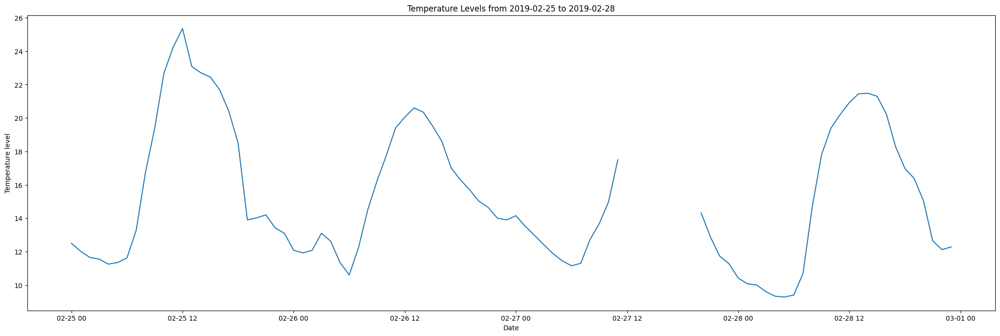

In [79]:
pollutant_list=['Temperature']
plot_columns(df,pollutant_list,'2019-02-25','2019-02-28')

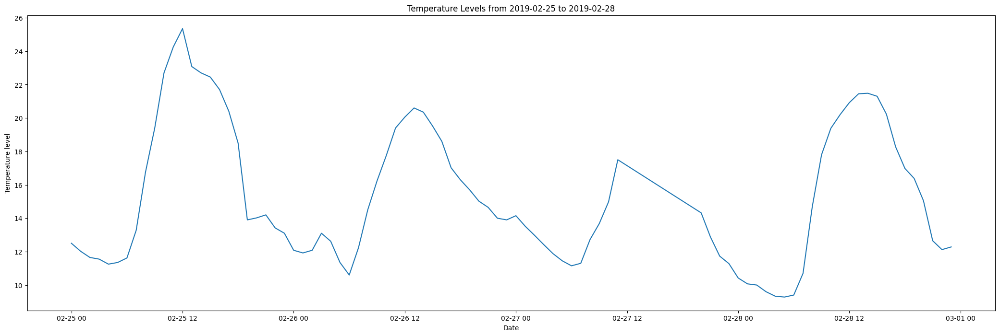

In [80]:
pollutant_list=['Temperature']
plot_columns(df_interpol,pollutant_list,'2019-02-25','2019-02-28')

### Imputation using KNN imputation

In [81]:
df_knn=df.copy(deep=True)

In [82]:
from sklearn.impute import KNNImputer
df_knn=df.copy(deep=True)

In [83]:
knn_imputer=KNNImputer(n_neighbors=3, weights="distance")
df_knn['Temperature']=knn_imputer.fit_transform(df_knn[['Temperature']])
df_knn['Temperature'].isna().sum()

0

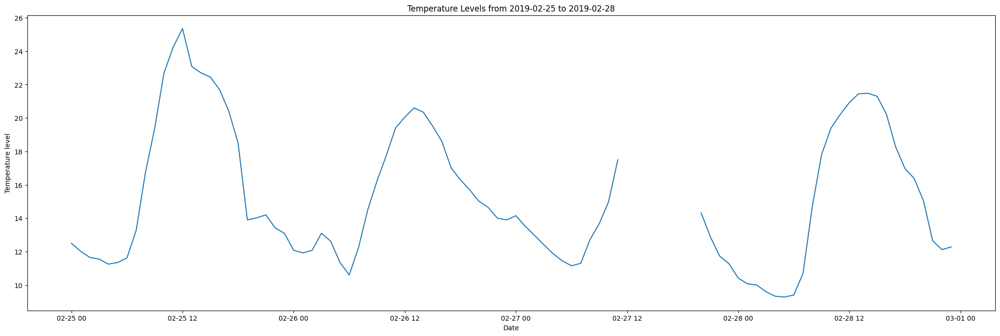

In [84]:
pollutant_list=['Temperature']
plot_columns(df,pollutant_list,'2019-02-25','2019-02-28')

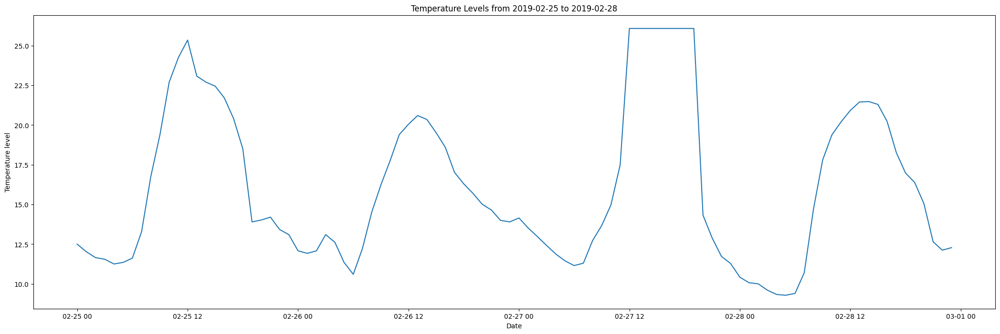

In [85]:
pollutant_list=['Temperature']
plot_columns(df_knn,pollutant_list,'2019-02-25','2019-02-28')

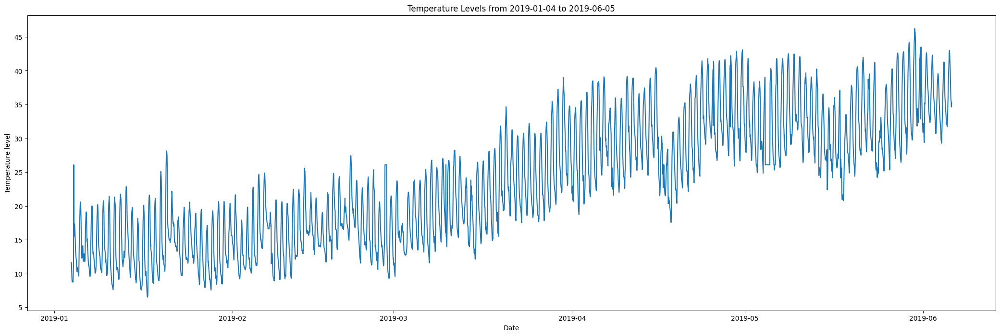

In [86]:
pollutant_list=['Temperature']
plot_columns(df_knn,pollutant_list,'2019-01-04','2019-06-05')

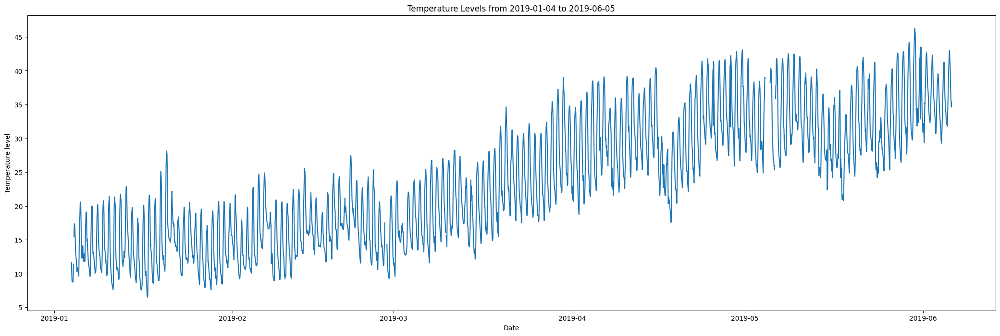

In [87]:
pollutant_list=['Temperature']
plot_columns(df,pollutant_list,'2019-01-04','2019-06-05')

### Imputation using Multivariate imputation by chained equations (MICE)

In [88]:
from sklearn.experimental import enable_iterative_imputer
from sklearn.impute import IterativeImputer
df_mice= df.copy(deep=True)

mice_imputer = IterativeImputer()
df_mice['Temperature'] = mice_imputer.fit_transform(df_mice[['Temperature']])

In [89]:
df_mice['Temperature'].isna().sum()

0

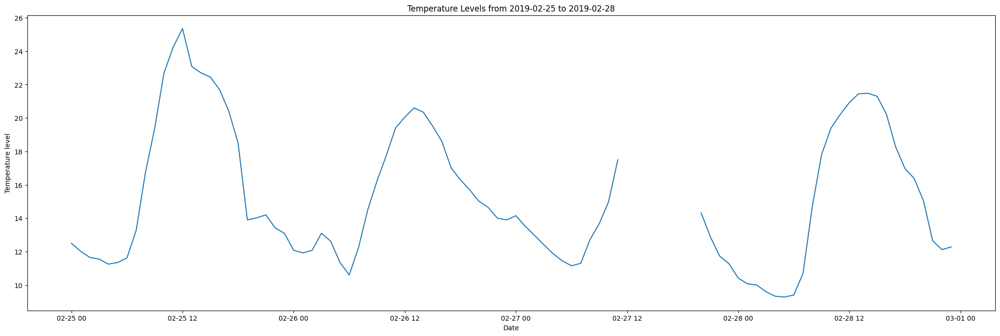

In [90]:
pollutant_list=['Temperature']
plot_columns(df,pollutant_list,'2019-02-25','2019-02-28')

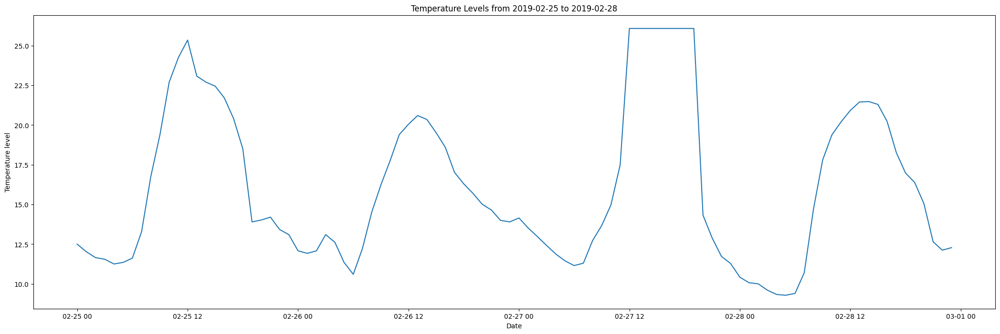

In [91]:
pollutant_list=['Temperature']
plot_columns(df_mice,pollutant_list,'2019-02-25','2019-02-28')

### Imputation using Iterative imputer

In [92]:
from sklearn.impute import IterativeImputer

In [93]:
df_iter=df.copy()

In [94]:
it_imputer=IterativeImputer()

In [95]:
df_iter['Temperature']=it_imputer.fit_transform(df_iter[['Temperature']])

In [96]:
df_iter['Temperature'].isna().sum()

0

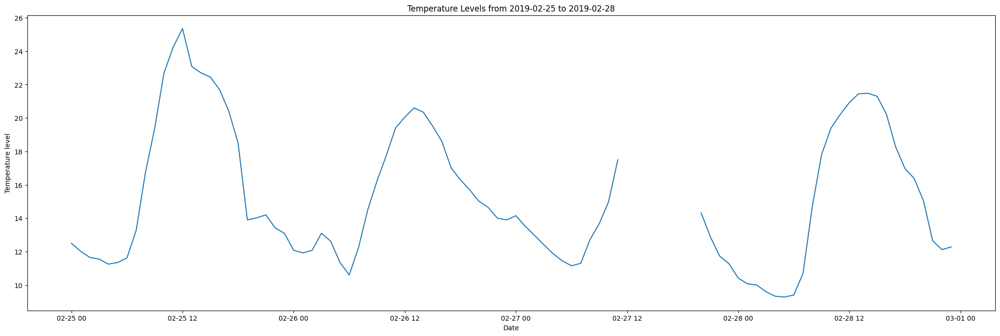

In [97]:
pollutant_list=['Temperature']
plot_columns(df,pollutant_list,'2019-02-25','2019-02-28')

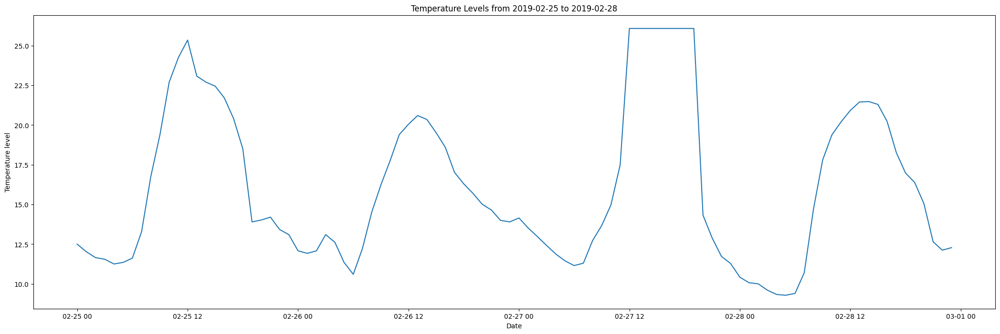

In [98]:
pollutant_list=['Temperature']
plot_columns(df_iter,pollutant_list,'2019-02-25','2019-02-28')

# Plotly Plotting

In [99]:
import plotly.express as px

fig=px.line(df,x=df.index,y='PM2.5', title='PM2.5 with slider')

fig.update_xaxes(
    rangeslider_visible=True,
    rangeselector=dict(
        buttons=list([
            dict(count=1, label="ly", step="year", stepmode="backward"),
            dict(count=2, label="2y", step="year", stepmode="backward"),
            dict(count=3, label="3y", step="year", stepmode="backward"),
            dict(count=4, label="4y", step="year", stepmode="backward"),
            dict(step="all")
        ])
    )
)
fig.show()

In [100]:
import plotly.express as px
import plotly.graph_objects as go

In [101]:
def plot_columns_plotly(data, columns, start_date, end_date):
    data.index = pd.to_datetime(data.index)
    filtered_data = data.loc[start_date:end_date]

    for col in columns:
        if col in filtered_data.columns:
            fig = px.line(
                filtered_data,
                x=filtered_data.index,
                y=col,
                title=f'{col} Levels from {start_date} to {end_date}'
            )
            
            fig.update_xaxes(
                rangeslider_visible=True,
                rangeselector=dict(
                    buttons=list([
                        dict(count=1, label="1y", step="year", stepmode="backward"),
                        dict(count=2, label="2y", step="year", stepmode="backward"),
                        dict(count=3, label="3y", step="year", stepmode="backward"),
                        dict(count=4, label="4y", step="year", stepmode="backward"),
                        dict(step="all")
                    ])
                )
            )
            
            fig.update_layout(
                yaxis_title=f'{col} level',
                xaxis_title='Date'
            )
            
            fig.show()

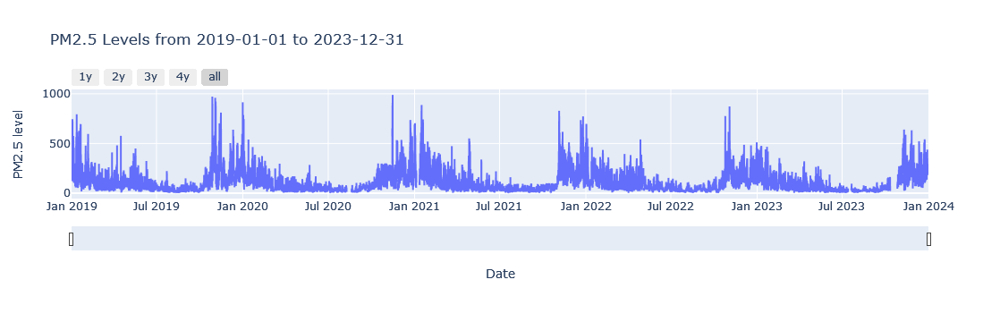

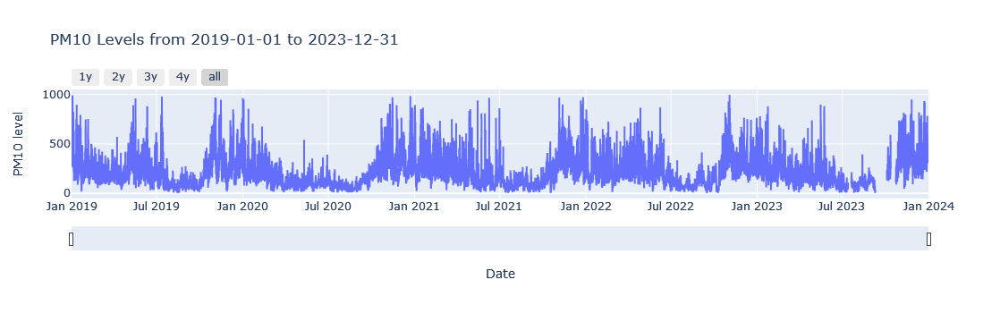

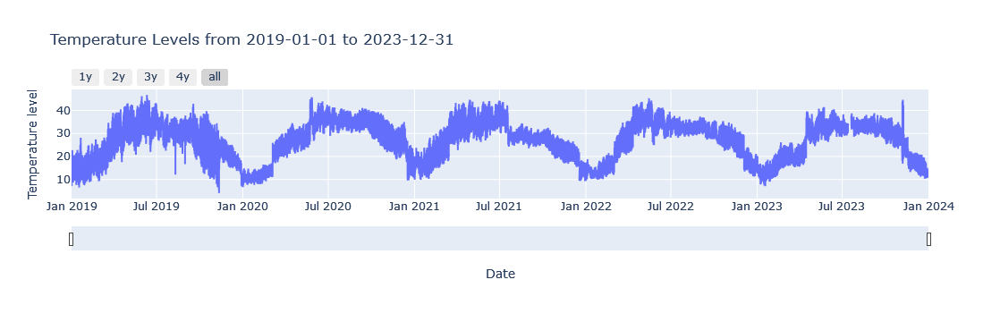

In [102]:
col_list = ['PM2.5', 'PM10','Temperature']
plot_columns_plotly(df, col_list, '2019-01-01', '2023-12-31')

In [103]:
def plot_columns_resampled_plotly(data, columns, start_date, end_date, freq, agg_func):
    data.index=pd.to_datetime(data.index)

    filtered_data=data.loc[start_date:end_date]
    
    resampled_data=filtered_data.resample(freq).apply(agg_func)
    if isinstance(agg_func, str):
        agg_name=agg_func.capitalize()
    else:
        agg_name=agg_func.__name__.capitalize() if hasattr(agg_func, '__name__') else 'Custom Function'
    
    for col in columns:
        if col in resampled_data.columns:
            fig=px.line(
                resampled_data,
                x=resampled_data.index,
                y=col,
                title=f'{agg_name} {col} Levels from {start_date} to {end_date} (Resampled: {freq})',
                labels={'x': 'Date', 'y': f'{col} level ({agg_name})'}
            )
            
            fig.add_shape(
                type="line",
                x0=pd.to_datetime('2020-03-01'),
                x1=pd.to_datetime('2020-03-01'),
                y0=resampled_data[col].min(),
                y1=resampled_data[col].max(),
                line=dict(color='red', width=2, dash='dash'),
                name='Lockdown Starts'
            )
            
            fig.update_xaxes(
                rangeslider_visible=True,
                rangeselector=dict(
                    buttons=[
                        dict(count=1, label="1y", step="year", stepmode="backward"),
                        dict(count=2, label="2y", step="year", stepmode="backward"),
                        dict(count=3, label="3y", step="year", stepmode="backward"),
                        dict(count=4, label="4y", step="year", stepmode="backward"),
                        dict(step="all")
                    ]
                )
            )
            
            fig.update_layout(
                yaxis_title=f'{col} level ({agg_name})',
                xaxis_title='Date',
                legend_title='Legend',
                legend=dict(x=0, y=1, traceorder='normal'),
                xaxis_rangeslider_visible=True,
                title_x=0.5
            )
            
            fig.show()
        else:
            print(f"Pollutant '{col}' not found in the dataset.")

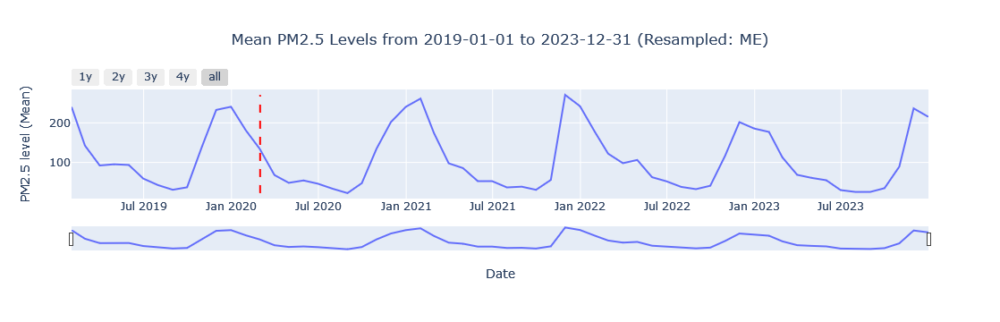

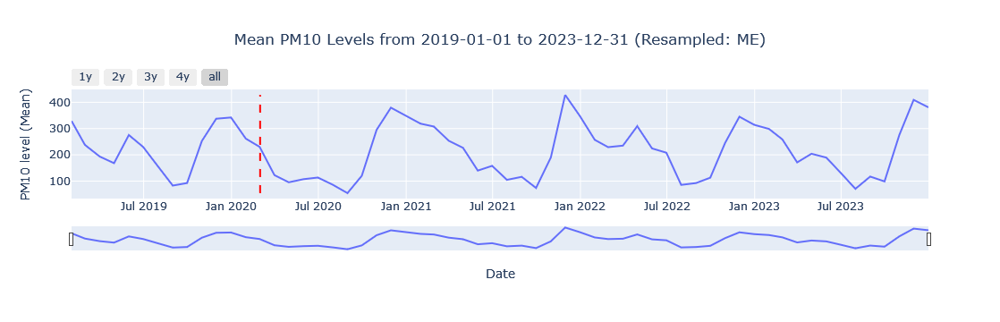

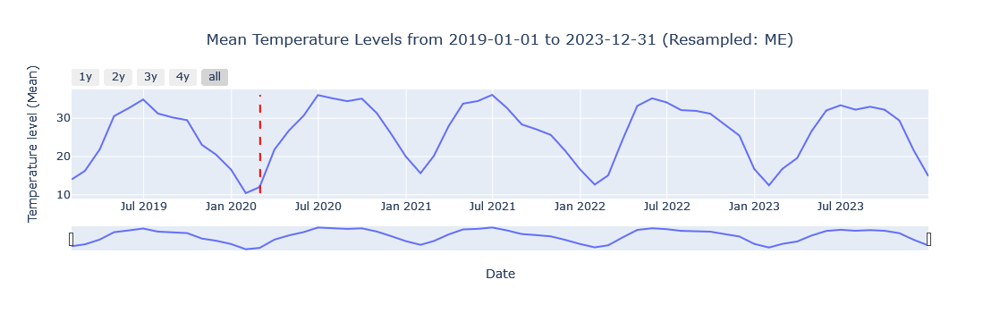

In [104]:
col_list=['PM2.5', 'PM10','Temperature']
plot_columns_resampled_plotly(df, col_list, '2019-01-01', '2023-12-31', 'ME', 'mean')